In [3]:
import numpy as np
import pandas as pd
import tqdm
import re
from lightfm import LightFM

/opt/anaconda3/lib/python3.8/site-packages/lightfm/_lightfm_fast.py:9: UserWarning: LightFM was compiled without OpenMP support. Only a single thread will be used.
  warnings.warn(


In [8]:
from io import BytesIO
from PIL import Image
import requests
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics.pairwise import cosine_similarity
import gensim
from scipy.sparse import coo_matrix, csr_matrix
from scipy.sparse.linalg import svds

In [9]:
Int = pd.read_csv('Interactions-3.csv')
items = pd.read_csv("items_with_text.csv")

In [10]:
items["picture_url"][12]

'https://img.mvideo.ru/Pdb/10010523b.jpg'

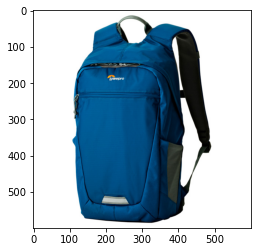

In [11]:
r = requests.get('https://img.mvideo.ru/Pdb/10010523b.jpg')
im = Image.open(BytesIO(r.content))
plt.imshow(im)

In [12]:
Int["page_type"].value_counts()

PRODUCT     602024
CART         35396
PURCHASE      8715
Name: page_type, dtype: int64

In [13]:
items.shape

(4185, 2)

In [14]:
Int = Int.merge(items[["picture_url", "text"]].drop_duplicates(), on=["picture_url"])

In [15]:
def chunks(l, n):
    for i in range(0, len(l), n):
        yield l[i:i + n]

def rec_imaging(product_ids, content_dict, measure=None, top_n=5):
    picture_urls = [content_dict[i] for i in product_ids]
    cnt = 0
    for idx, chunk in enumerate(chunks(picture_urls, top_n)):
        fig = plt.figure(figsize=(20, 4))
        for n, i in enumerate(chunk):
            try:
                r = requests.get(i)
                im = Image.open(BytesIO(r.content))

            except:
                print('Something went wrong with {url}'.format(url=i))
                continue

            a = fig.add_subplot(1, top_n, n + 1)
            if measure is not None:
                a.title.set_text("measure = {}".format(np.round(measure[cnt], 4)))
                cnt += 1
            plt.imshow(im)
            plt.axis('off')
        plt.show()

# Холодный старт

# Самые популярные

Посмотрим, какие товары у нас самые популярные в разных разрезах (просмотр / корзина / покупка) 

In [16]:
class Top():
    def __init__(self, Int):
        # Создаём словарь для того, чтобы по product_id возвращать url товара
        self.product_id_to_url = {}
        for i in Int[["product_id", "picture_url"]].drop_duplicates().values:
            self.product_id_to_url[i[0]] = i[1]
        self.interactions = Int
        
    def top_items(self):
        # Хотим получить в отсортированном порядке датафрейм - product_id, user_number
        items = self.interactions[self.interactions["page_type"] == "CART"]\
                                                .groupby("product_id")["vid"].count() \
                                                .reset_index() \
                                                .sort_values("vid", ascending=False)[:30]
        
        rec_imaging(items["product_id"].values, self.product_id_to_url, items["vid"].values)

In [17]:
T = Top(Int)

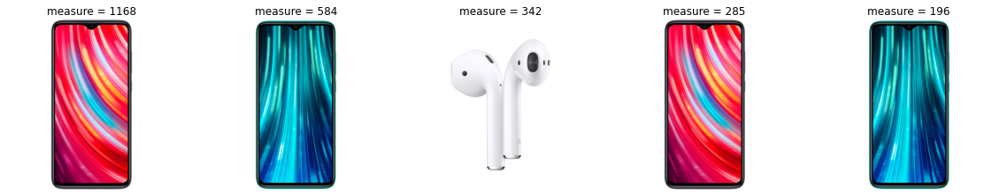

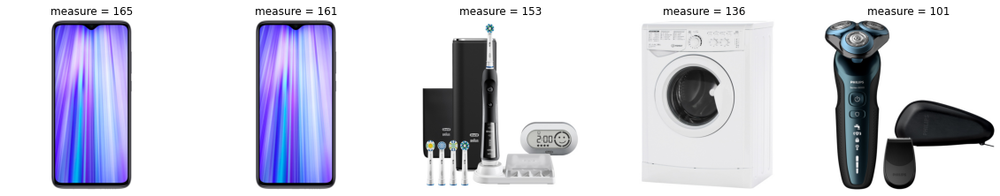

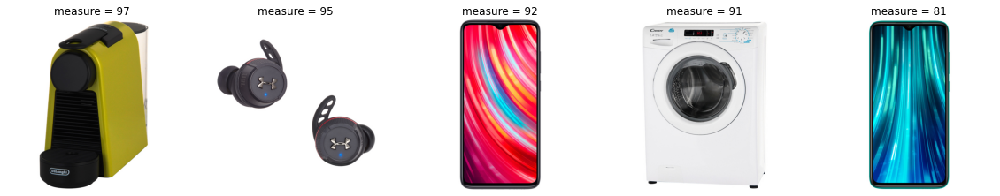

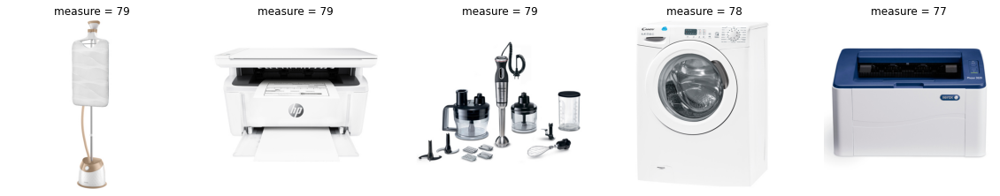

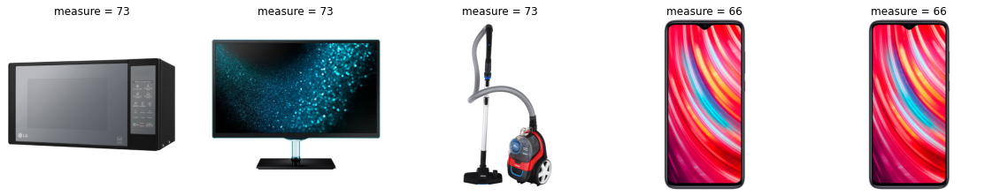

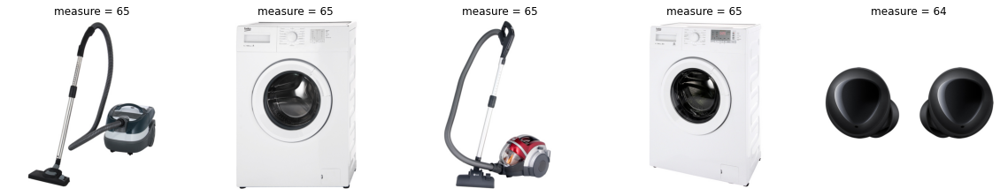

In [18]:
T.top_items()

# Cовстречаемость

In [19]:
Int_tmp = Int[["vid", "product_id"]].drop_duplicates()

In [20]:
Int_tmp.head()

,vid,product_id
0,0,0
5,1,0
6,2,0
10,21291,245
12,22367,245


In [21]:
user_products = Int_tmp.groupby(["vid"])["product_id"].apply(list).reset_index()

In [22]:
user_products[:3]

,vid,product_id
0,0,[0]
1,1,"[0, 42341]"
2,2,"[0, 48833, 37522, 49883, 42341, 48743]"


In [23]:
class Recomendations():
    def __init__(self, Int):
        # Создаём словарь для того, чтобы по product_id возвращать url товара
        self.product_id_to_url = {}
        for i in Int[["product_id", "picture_url"]].drop_duplicates().values:
            self.product_id_to_url[i[0]] = i[1]
        self.interactions = Int
        
    def coocurrency_count(self):
        Int = self.interactions[["vid", "product_id"]].drop_duplicates()
        # Для каждого пользователя собираем товары, с которыми он взамиодействовал
        user_products = Int.groupby(["vid"])["product_id"].apply(list).reset_index()
        # Считаем число товаров, с которыми взаимодействовал каждый пользователь и записываем в колонку prod_num
        product_num = [len(i) for i in user_products["product_id"]]
        user_products["prod_num"] = product_num
        # Фильтруем пользователей, взаимодействовавших с одним товаром
        user_products = user_products[user_products["prod_num"] > 1]
        
        # Заводим словарь под товары
        cooc = {}
        for i in tqdm.tqdm_notebook(user_products.values):
            for j in range(len(i[1])):
                for k in range(len(i[1])):
                    if j != k:
                        try:
                            cooc[str(i[1][j]) + "_" + str(i[1][k])] += 1
                        except:
                            cooc[str(i[1][j]) + "_" + str(i[1][k])] = 1
        cooc_list = []
        for i, j in cooc.items():
            # Если товары встетились вместе больше одного раза, то добавляем в список
            if j != 1:
                cooc_list.append(i.split("_") + [j])
        self.cooc_rec = pd.DataFrame(cooc_list, columns=["item1", "item2", "measure"])
    
    def get_rec(self, i, show=False):
        recs = self.cooc_rec[self.cooc_rec["item1"] == str(i)]\
                            .sort_values("measure", ascending=False)\
                            .head(10)
        print(u"Для товара")
        rec_imaging([i], self.product_id_to_url)
        print(u"Такие рекомендации")
        rec_imaging(recs["item2"].values.astype(int), self.product_id_to_url, 
                         recs["measure"].values.astype(int))

In [24]:
cooc_rec = Recomendations(Int)
cooc_rec.coocurrency_count()

<ipython-input-23-bc746ecc6ff3>:21: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for i in tqdm.tqdm_notebook(user_products.values):


In [25]:
cooc_rec.cooc_rec.sort_values("measure", ascending=False)

,item1,item2,measure
228,1181,381,1214
229,381,1181,1214
709,381,384,1101
718,384,381,1101
6012,384,1181,905
...,...,...,...
55436,25317,10448,2
55437,25317,25316,2
55438,253,27324,2
55439,3453,27324,2


Для товара


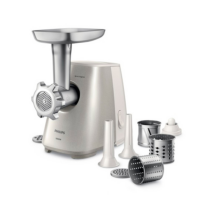

Такие рекомендации


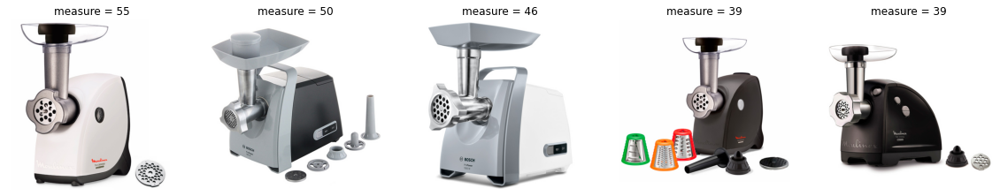

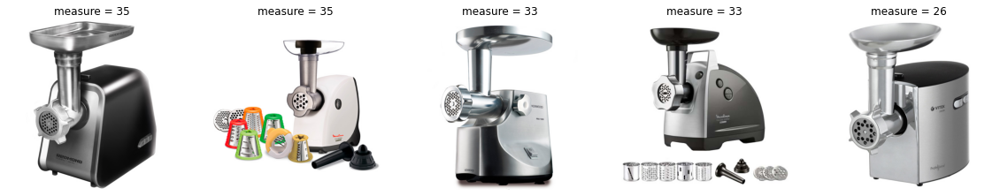

In [26]:
cooc_rec.get_rec(10)

Для товара


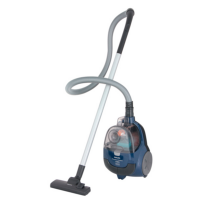

Такие рекомендации


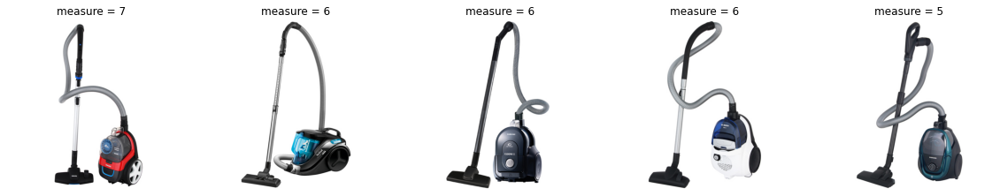

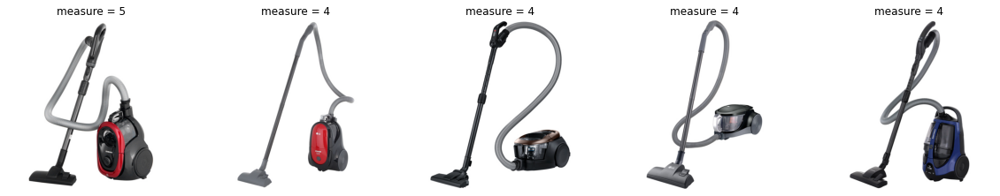

In [27]:
cooc_rec.get_rec(121)

Для товара


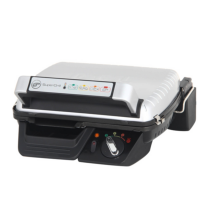

Такие рекомендации


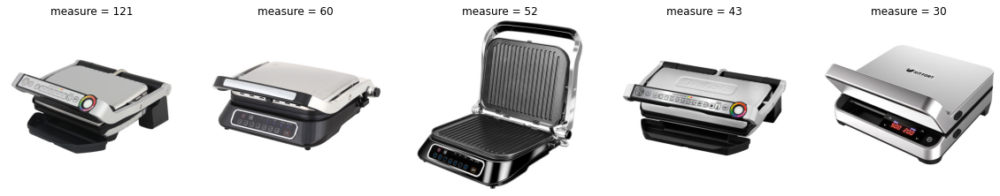

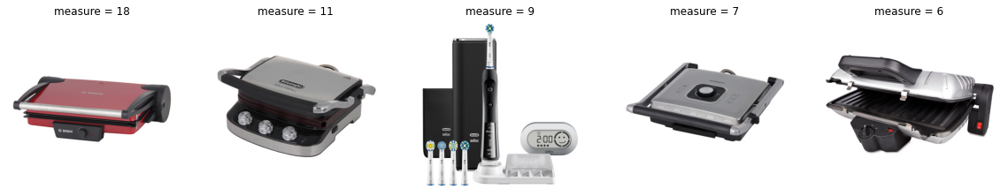

In [28]:
cooc_rec.get_rec(42)

Для товара


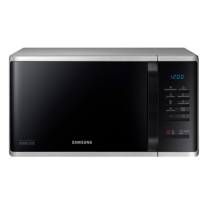

Такие рекомендации


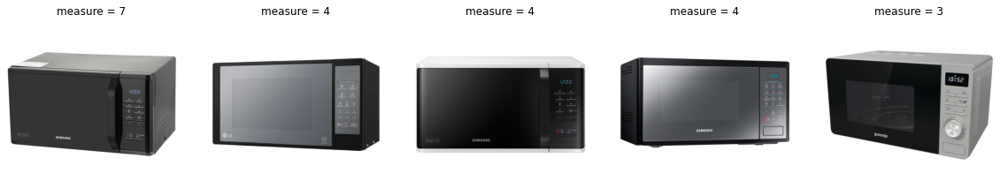

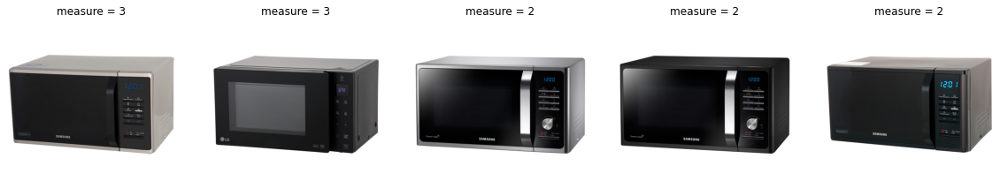

In [29]:
cooc_rec.get_rec(1111)

Для товара


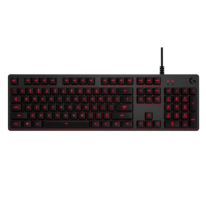

Такие рекомендации


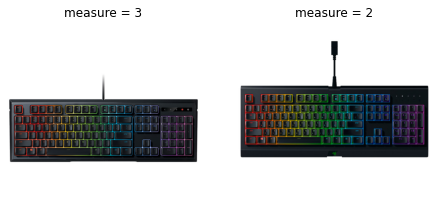

In [30]:
cooc_rec.get_rec(1236)

Для товара


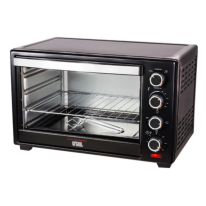

Такие рекомендации


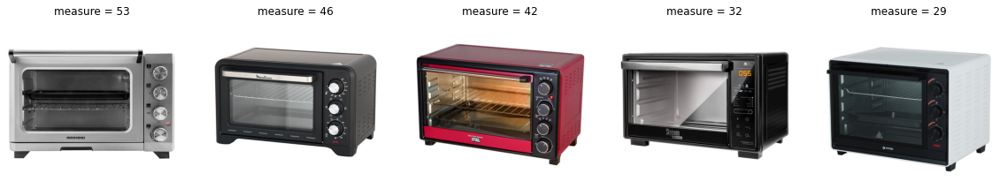

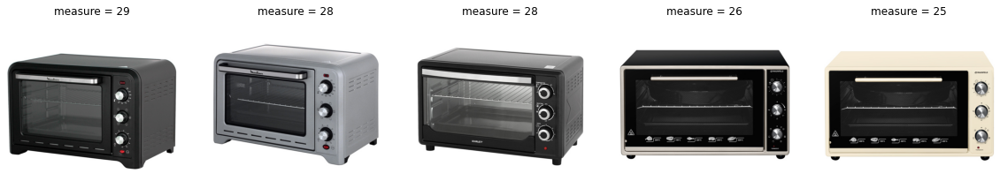

In [31]:
cooc_rec.get_rec(1362)

Для товара


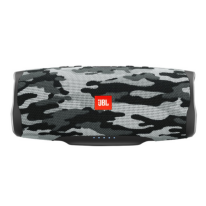

Такие рекомендации


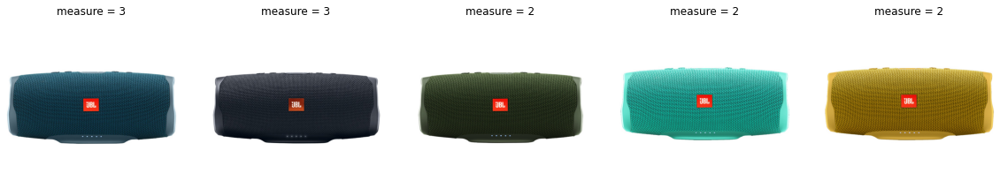

In [32]:
cooc_rec.get_rec(1002)

Для товара


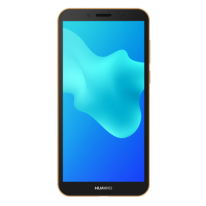

Такие рекомендации


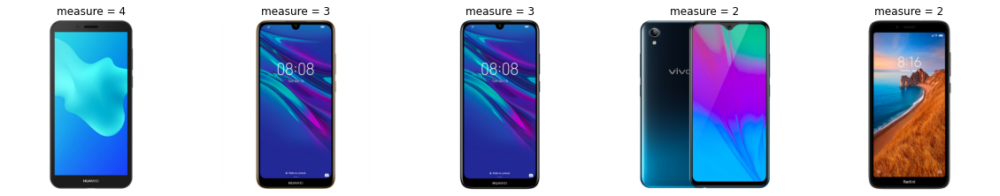

In [33]:
cooc_rec.get_rec(1245)

Для товара


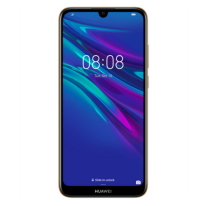

Такие рекомендации


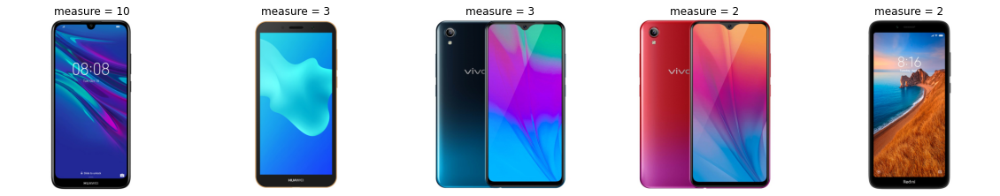

In [34]:
cooc_rec.get_rec(1247)

Для товара


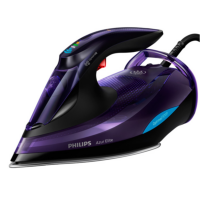

Такие рекомендации


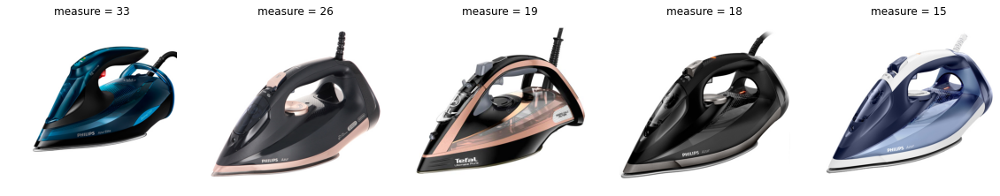

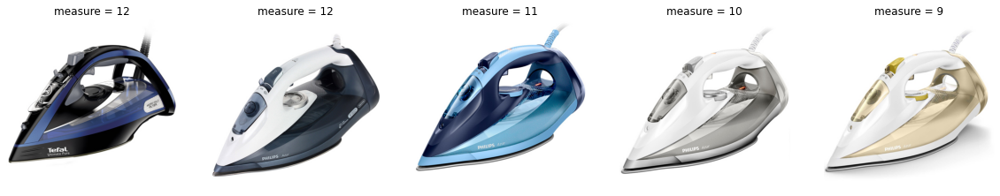

In [35]:
cooc_rec.get_rec(3453)

Для товара


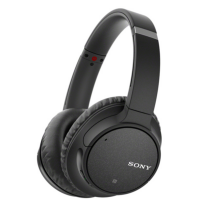

Такие рекомендации


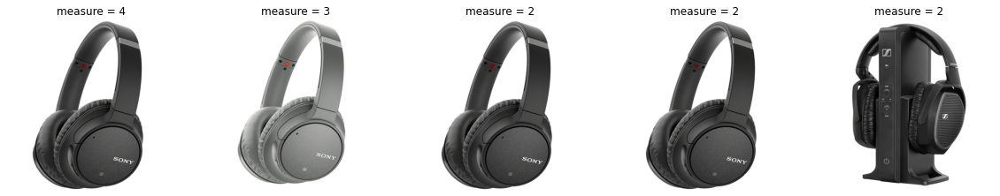

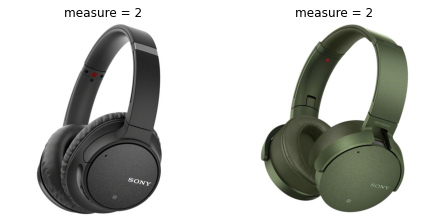

In [36]:
cooc_rec.get_rec(3445)

Для товара


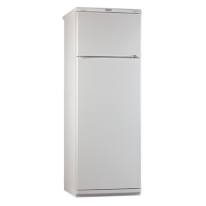

Такие рекомендации


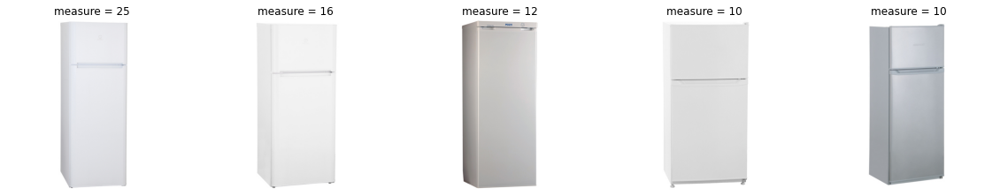

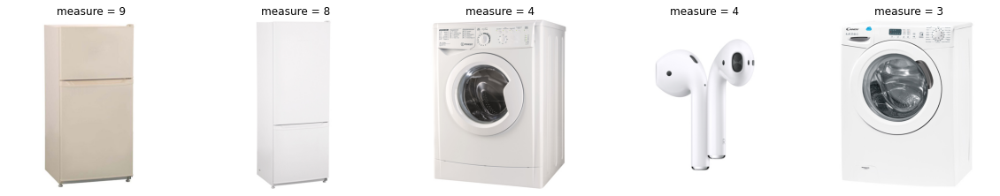

In [37]:
cooc_rec.get_rec(667)

Для товара


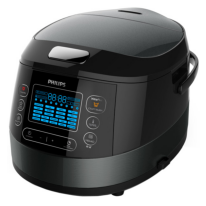

Такие рекомендации


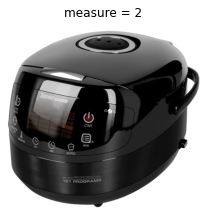

In [38]:
cooc_rec.get_rec(1231)

Для товара


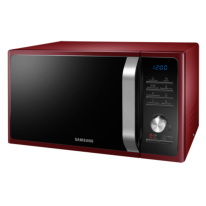

Такие рекомендации


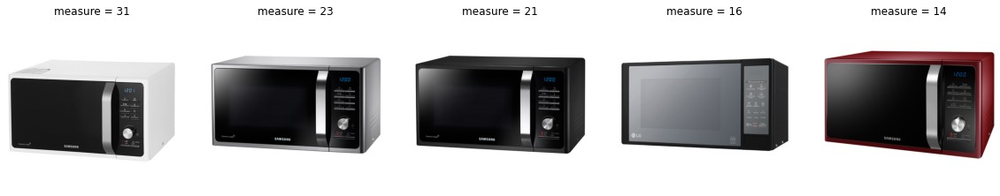

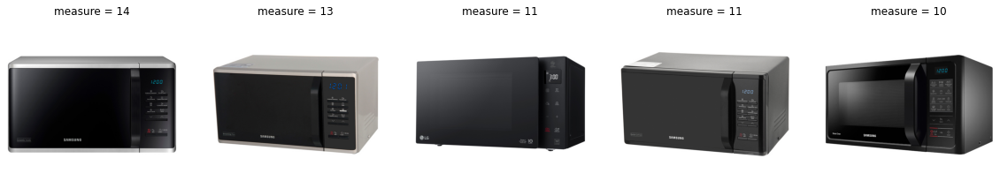

In [39]:
cooc_rec.get_rec(1226)

Для товара


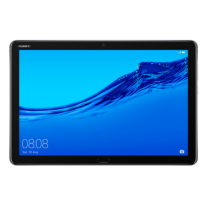

Такие рекомендации


In [40]:
cooc_rec.get_rec(1212)

Для товара


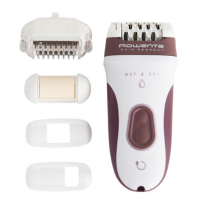

Такие рекомендации


In [41]:
cooc_rec.get_rec(631)

# Content-based

In [42]:
class Content_Based():
    def __init__(self, items, interactions):
        self.items = items
        self.interactions = interactions.drop_duplicates()
        self.content_dict = {}
        for i, j in enumerate(items["picture_url"]):
            self.content_dict[i] = j
        self.inversed_dict = {v: k for k, v in self.content_dict.items()}
        
    def avg_feature_vector(self, words, model, num_features, index2word_set):
        feature_vec = np.zeros((num_features, ), dtype='float32')
        n_words = 0
        for word in words:
            if word in index2word_set:
                n_words += 1
                feature_vec = np.add(feature_vec, model.wv[word])
        if (n_words > 0):
            feature_vec = feature_vec / n_words
        return feature_vec

    def get_items_representation(self):
        
        item_description = [gensim.utils.simple_preprocess(re.sub("[^a-zA-Zа-яА-Я]+", " ", i.lower())) 
                            for i in self.items['text']]
        #build vocabulary and train model
        self.model = gensim.models.Word2Vec(
                item_description,
                size=200,
                window=10,
                min_count=1,
                workers=10,
                iter=100)
        self.index2word_set = set(self.model.wv.index2word)
        self.items_embs = np.zeros((len(item_description), 200))
        for i in range(self.items_embs.shape[0]):
            self.items_embs[i] = self.avg_feature_vector(item_description[i], self.model, 200, self.index2word_set)
        
        
    def get_rec_I2I(self, i):
        metrics = cosine_similarity([self.items_embs[i]], self.items_embs)
        print(u"Для товара")
        rec_imaging([i], self.content_dict)
        print(u"Такие рекомендации")
        rec_imaging(np.argsort(metrics)[0][::-1][1:11], self.content_dict, np.sort(metrics)[0][::-1][1:11])


    def get_rec_U2I(self, i):
        ui = self.interactions[self.interactions["vid"] == i]
        user_vector = " ".join(ui["text"])
        user_processed = gensim.utils.simple_preprocess(re.sub("[^a-zA-Zа-яА-Я]+", " ", user_vector.lower()))
        user_emb = self.avg_feature_vector(user_processed, self.model, 200, self.index2word_set)
        metrics = cosine_similarity([user_emb], self.items_embs)
        print(u"Для пользователя, который взаимодействовал с товарами")
        rec_imaging(np.unique([self.inversed_dict[i] for i in ui["picture_url"]]), self.content_dict)
        print(u"Такие рекомендации")
        rec_imaging(np.argsort(metrics)[0][::-1][1:11], self.content_dict, np.sort(metrics)[0][::-1][1:11])

In [43]:
" ".join(Int[Int["vid"] == 121]["text"])

'20061538 282 tia 14 450 indesit холодильник холодильники с верхней морозильной камерой 20061744 115 cx 343 332 516 nordfrost холодильник холодильники с верхней морозильной камерой 20061744 115 cx 343 332 516 nordfrost холодильник холодильники с верхней морозильной камерой 20061744 115 cx 343 332 516 nordfrost холодильник холодильники с верхней морозильной камерой 20061744 115 cx 343 332 516 nordfrost холодильник холодильники с верхней морозильной камерой 20061745 106 cx 343 732 450 nordfrost холодильник холодильники с верхней морозильной камерой 20061753 151 cx 341 332 510 nordfrost холодильник холодильники с верхней морозильной камерой'

In [44]:
CB = Content_Based(items, Int)

In [45]:
CB.get_items_representation()

Для товара


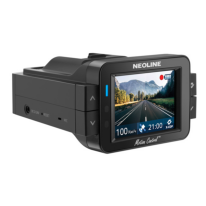

Такие рекомендации


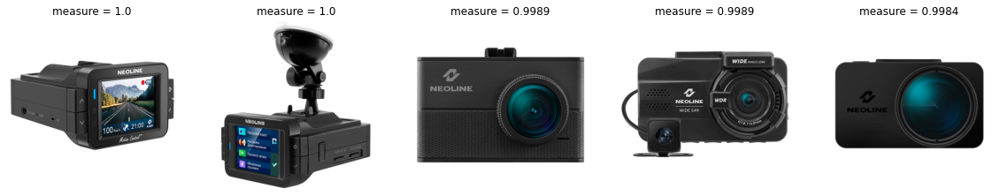

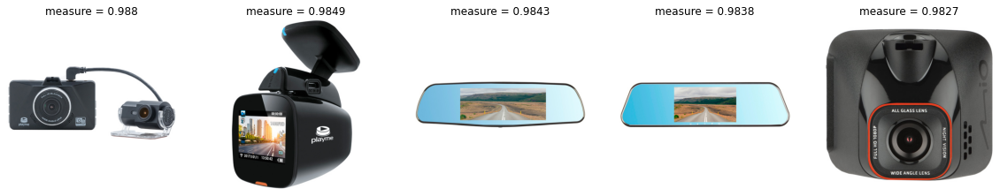

In [46]:
CB.get_rec_I2I(13)

Для товара


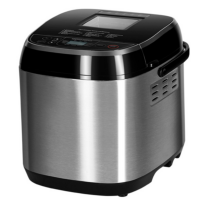

Такие рекомендации


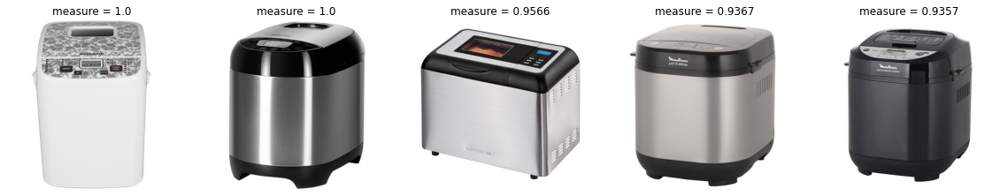

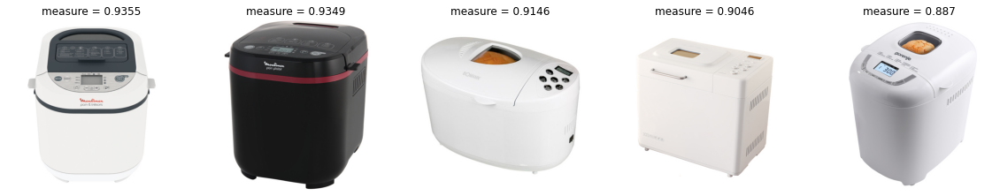

In [47]:
CB.get_rec_I2I(2145)

Для пользователя, который взаимодействовал с товарами


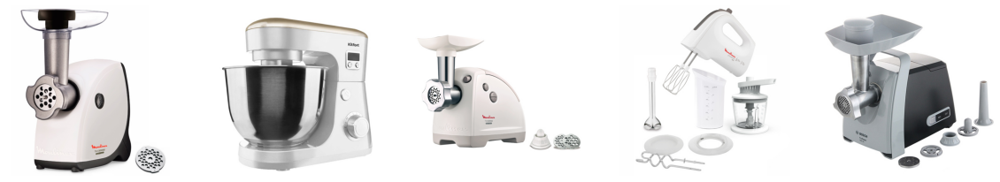

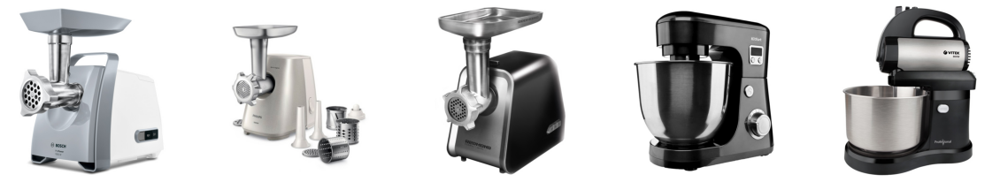

Такие рекомендации


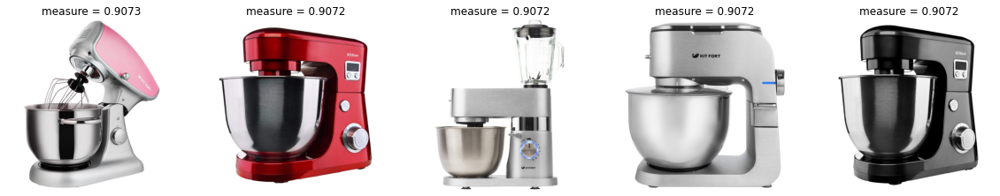

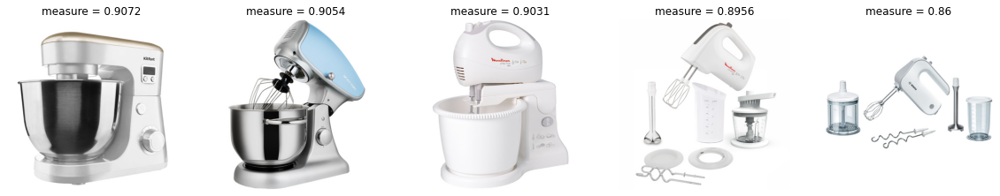

In [48]:
CB.get_rec_U2I(453)

Для пользователя, который взаимодействовал с товарами


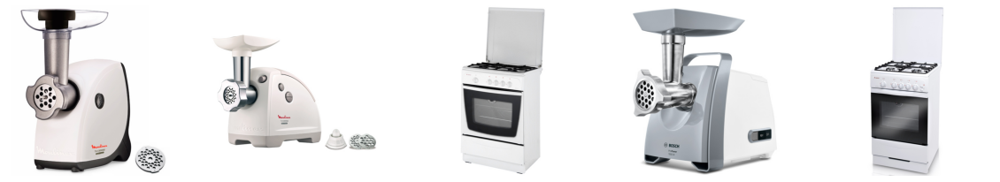

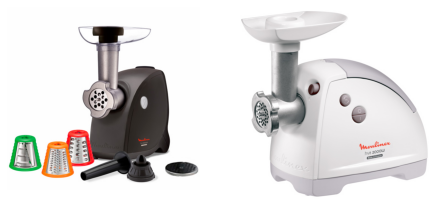

Такие рекомендации


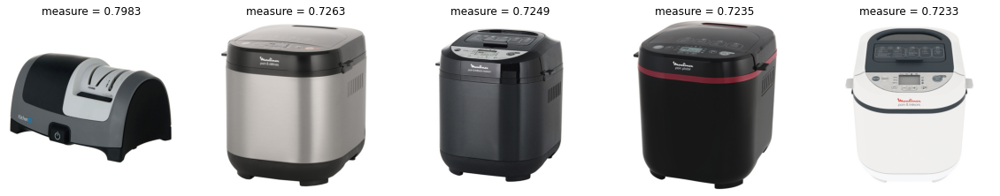

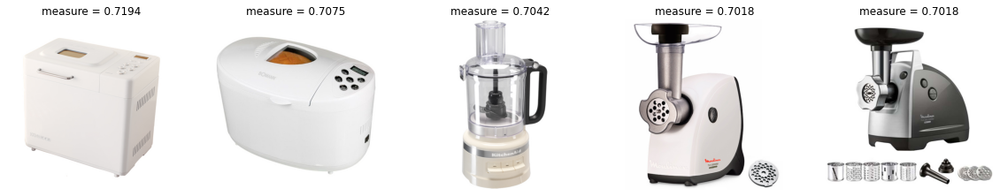

In [49]:
CB.get_rec_U2I(333)

Для пользователя, который взаимодействовал с товарами


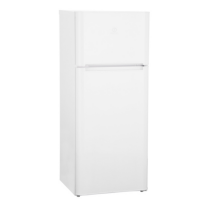

Такие рекомендации


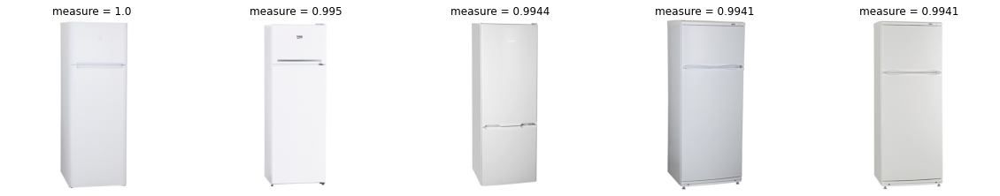

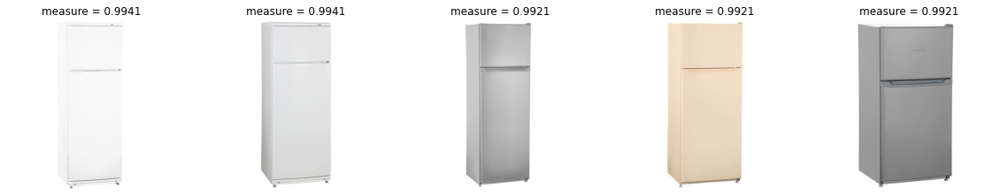

In [50]:
CB.get_rec_U2I(213)

Для пользователя, который взаимодействовал с товарами


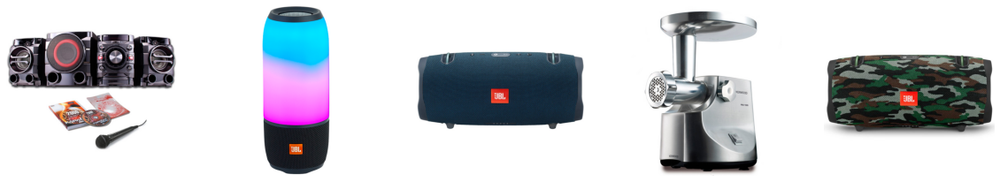

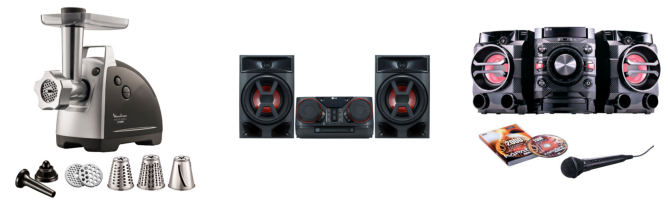

Такие рекомендации


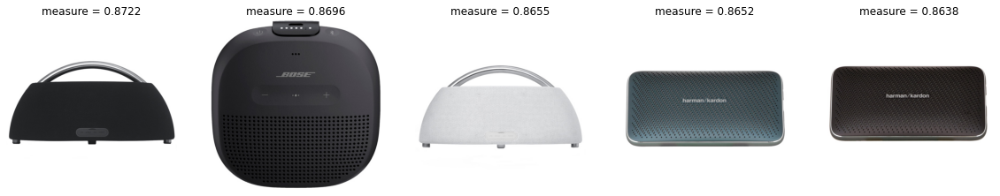

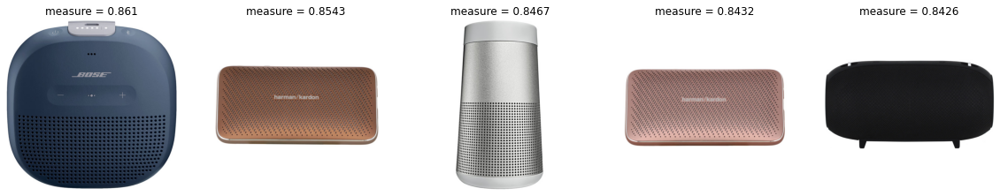

In [51]:
CB.get_rec_U2I(777)

Для пользователя, который взаимодействовал с товарами


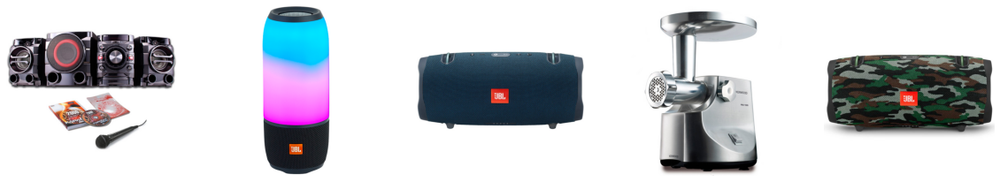

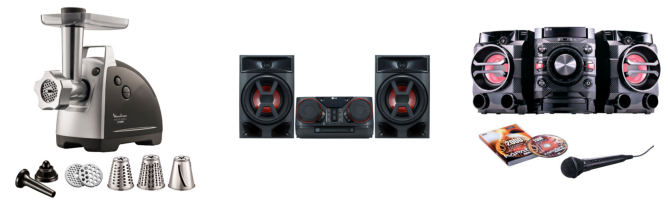

Такие рекомендации


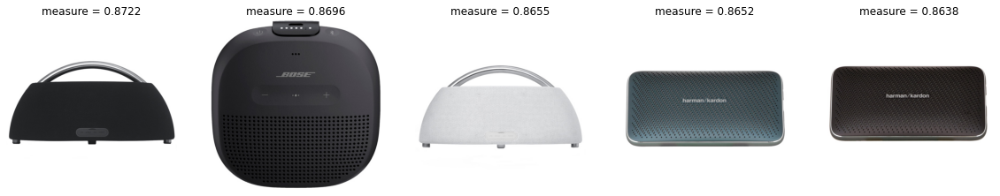

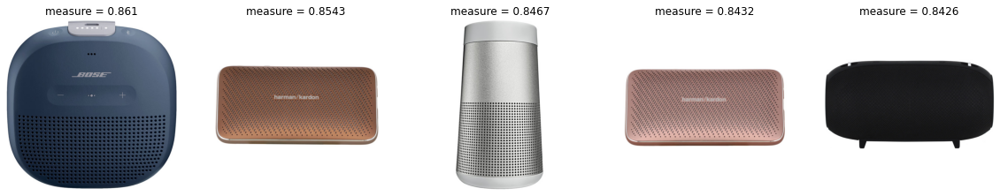

In [52]:
CB.get_rec_U2I(777)

# W2V recommendations

In [53]:
class W2V_REC():
    def __init__(self, interactions):
        self.interactions = interactions
        self.interactions["product_id"] = self.interactions["product_id"].astype(str)
        self.content_dict = {}
        for i, j in interactions[["product_id", "picture_url"]].drop_duplicates().values:
            self.content_dict[i] = j

    def get_w2v(self):
        interactions_sentences = self.interactions.groupby(["vid"])["product_id"].apply(list).reset_index()
        self.model = gensim.models.Word2Vec(
                                        interactions_sentences["product_id"].apply(list).values,
                                        size=200,
                                        window=10,
                                        min_count=1,
                                        workers=10,
                                        iter=100)
        self.index2word_set = set(self.model.wv.index2word)
        
    def avg_feature_vector(self, words):
        feature_vec = np.zeros(200, dtype='float32')
        n_words = 0
        for word in words:
            if word in self.index2word_set:
                n_words += 1
                feature_vec = np.add(feature_vec, self.model.wv[word])
        if (n_words > 0):
            feature_vec = feature_vec / n_words
        return feature_vec
    
    def get_rec_I2I(self, i):
        i = str(i)
        metrics = [j[1] for j in self.model.wv.similar_by_word(i)]
        items = [j[0] for j in self.model.wv.similar_by_word(i)]
        print(u"Для товара")
        r = requests.get(self.content_dict[i])
        im = Image.open(BytesIO(r.content))
        plt.imshow(im)
        plt.axis('off')
        plt.show()
        print(u"Такие рекомендации")
        rec_imaging(items, self.content_dict, metrics)

    def get_rec_U2I(self, i):
        user_items = list(self.interactions[self.interactions["vid"] == i]["product_id"].drop_duplicates())
        user_emb = self.avg_feature_vector(user_items)
        recs = self.model.wv.most_similar(positive=[user_emb], topn=10)
        metrics = [j[1] for j in recs]
        items = [j[0] for j in recs]
        print(u"Для пользователя, который взаимодействовал с товарами")
        rec_imaging(user_items, self.content_dict)
        print(u"Такие рекомендации")
        rec_imaging(items, self.content_dict, metrics)

In [54]:
w = W2V_REC(Int)
w.get_w2v()

Для товара


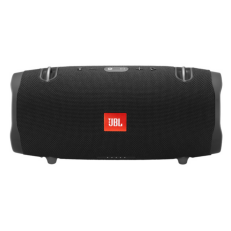

Такие рекомендации


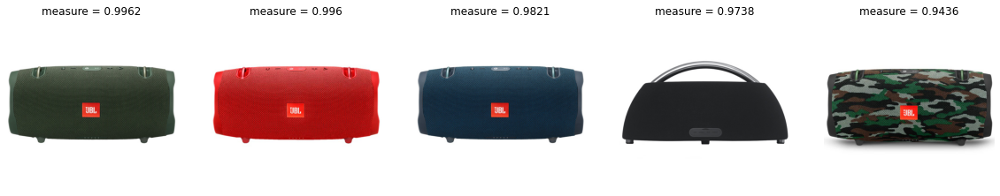

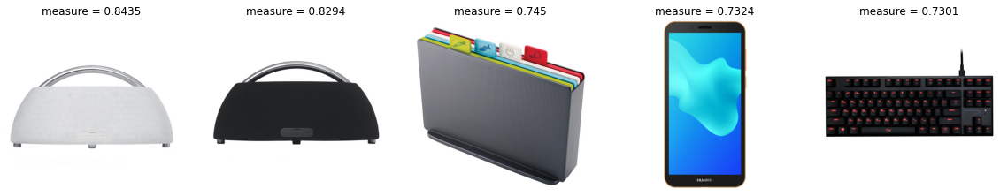

In [55]:
w.get_rec_I2I(0)

Для товара


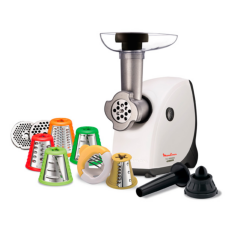

Такие рекомендации


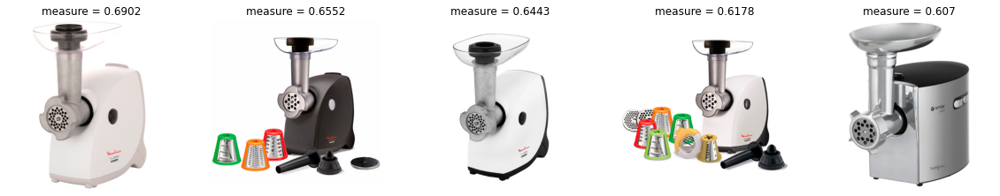

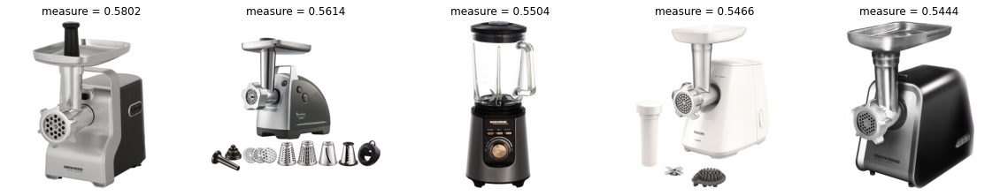

In [56]:
w.get_rec_I2I(13)

Для товара


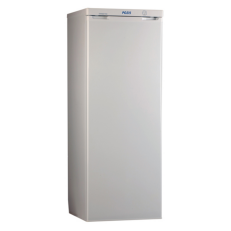

Такие рекомендации


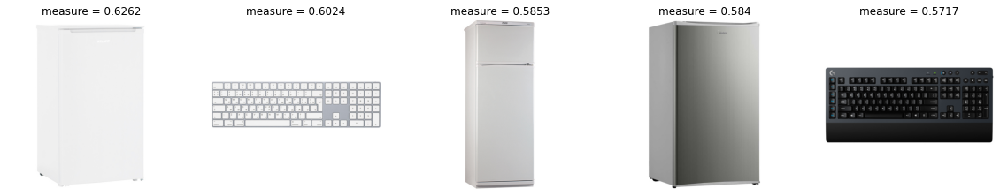

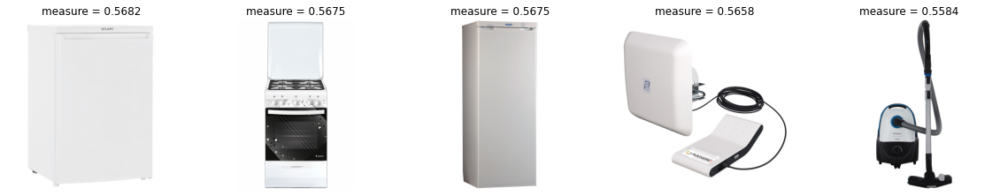

In [57]:
w.get_rec_I2I(666)

Для пользователя, который взаимодействовал с товарами


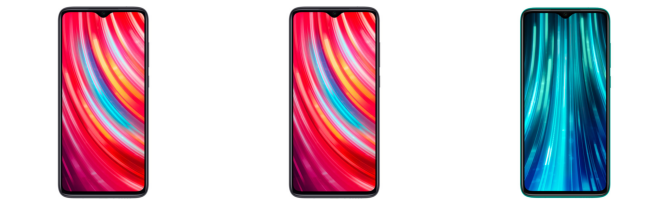

Такие рекомендации


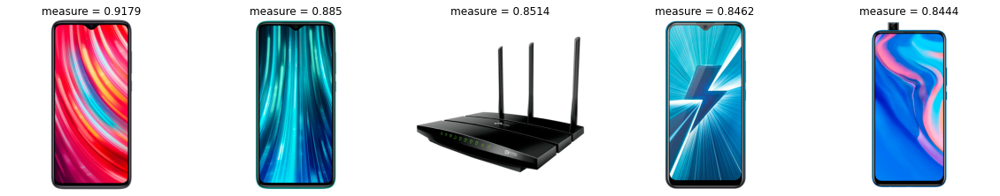

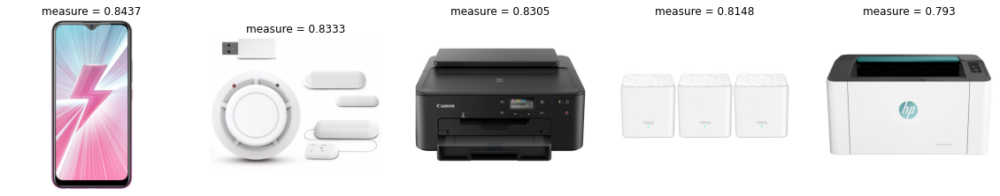

In [58]:
w.get_rec_U2I(42)

Для пользователя, который взаимодействовал с товарами


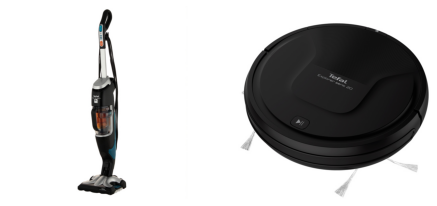

Такие рекомендации


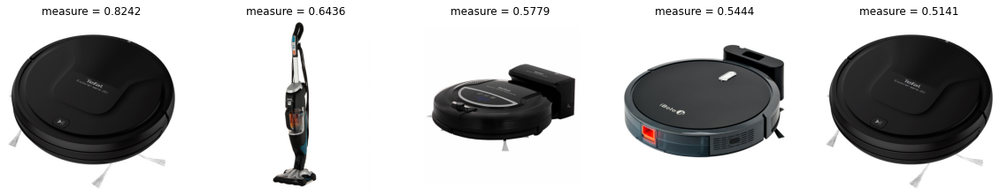

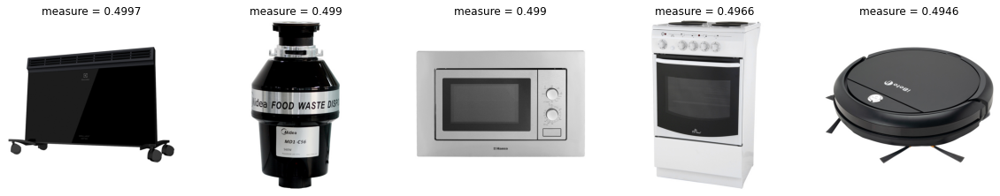

In [59]:
w.get_rec_U2I(4322)

Для пользователя, который взаимодействовал с товарами


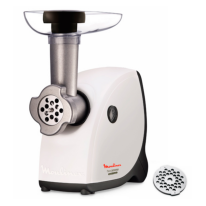

Такие рекомендации


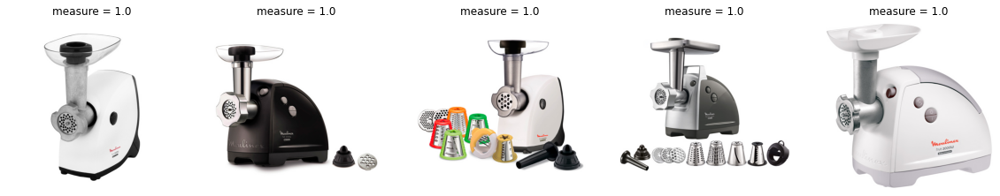

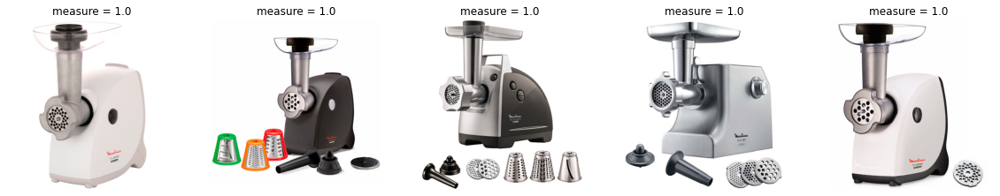

Для пользователя, который взаимодействовал с товарами


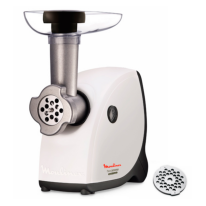

Такие рекомендации


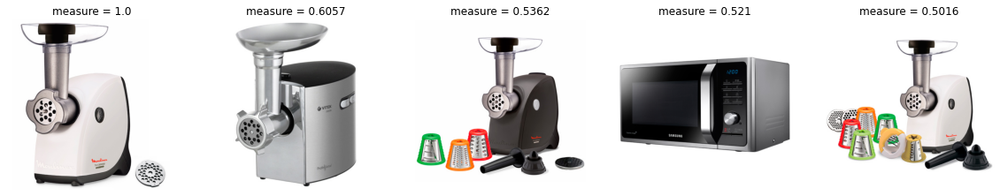

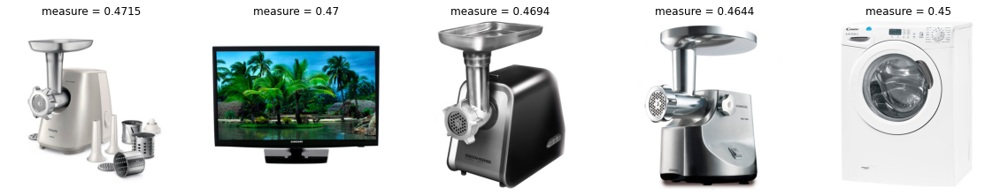

In [60]:
user = 555
CB.get_rec_U2I(user)
w.get_rec_U2I(user)

# Colloborative filtering

In [871]:
# Для простоты положим, что вес у всех типов взаимодействий одинаковый
df_weights = pd.DataFrame({"page_type": ["PRODUCT", "CART", "PURCHASE"],
                           'weight': [1, 1, 1]})

weighted = Int.merge(df_weights, on="page_type")\
                  .groupby(["vid", "product_id", "picture_url"])["weight"]\
                  .sum()\
                  .reset_index()

In [872]:
weighted["weight"] = (weighted["weight"] > 0).astype(int)

In [873]:
# заполним sparse матрицу
csr_rates = coo_matrix((weighted["weight"], (weighted["vid"], weighted["product_id"])), 
                    shape=(len(set(weighted["vid"])), len(set(weighted["product_id"]))))

In [874]:
csr_rates

<129920x60080 sparse matrix of type '<class 'numpy.int64'>'
	with 359731 stored elements in COOrdinate format>

In [875]:
user_rates = csr_rates.getrow(12).toarray()[0]

In [876]:
measure = cosine_similarity([user_rates], csr_rates).reshape(-1, 1)

In [877]:
np.sort(measure.ravel())

array([0.        , 0.        , 0.        , ..., 0.81649658, 0.81649658,
       1.        ])

In [878]:
idx = 0

In [879]:
user_rates = csr_rates.getrow(idx).toarray()[0]
watched_items = np.where(user_rates != 0)[0]
metrics = cosine_similarity([user_rates], csr_rates).reshape(-1, 1)
# домножаем оценки пользователя на коэффициент похожести
rates = csr_matrix.multiply(csr_rates.copy(), metrics)

In [880]:
rates

<129920x60080 sparse matrix of type '<class 'numpy.float64'>'
	with 359731 stored elements in COOrdinate format>

In [70]:
user_rates

array([1, 0, 0, ..., 0, 0, 0])

In [71]:
metrics

array([[1.        ],
       [0.70710678],
       [0.40824829],
       ...,
       [0.        ],
       [0.        ],
       [0.        ]])

In [72]:
ex_df = pd.DataFrame([[1, 0, 0, 1, 0, 0],
              [0, 0, 0, 1, 0, 1],
              [1, 1, 0, 1, 0, 1],
              [0, 0, 0, 0, 1, 1],
              [0, 0, 0, 0, 1, 1],
              [1, 1, 0, 1, 0, 1]], columns=["яблоко", "груша", "апельсин", "ананас", "кокос", "виноград"],
            index=["Вася", "Петя", "Паша", "Олег", "Марина", "Вероника"])

In [73]:
ex_df

,яблоко,груша,апельсин,ананас,кокос,виноград
Вася,1,0,0,1,0,0
Петя,0,0,0,1,0,1
Паша,1,1,0,1,0,1
Олег,0,0,0,0,1,1
Марина,0,0,0,0,1,1
Вероника,1,1,0,1,0,1


In [74]:
user_rates = ex_df.iloc[1].values

In [75]:
user_rates

array([0, 0, 0, 1, 0, 1])

In [76]:
metrics = cosine_similarity([user_rates], ex_df.values).reshape(-1, 1)

In [77]:
metrics

array([[0.5       ],
       [1.        ],
       [0.70710678],
       [0.5       ],
       [0.5       ],
       [0.70710678]])

In [78]:
rates = ex_df.values * metrics

In [79]:
pd.DataFrame(rates, columns=["яблоко", "груша", "апельсин", "ананас", "кокос", "виноград"],
            index=["Вася", "Петя", "Паша", "Олег", "Марина", "Вероника"])

,яблоко,груша,апельсин,ананас,кокос,виноград
Вася,0.500000,0.000000,0.0,0.500000,0.0,0.000000
Петя,0.000000,0.000000,0.0,1.000000,0.0,1.000000
Паша,0.707107,0.707107,0.0,0.707107,0.0,0.707107
Олег,0.000000,0.000000,0.0,0.000000,0.5,0.500000
Марина,0.000000,0.000000,0.0,0.000000,0.5,0.500000
Вероника,0.707107,0.707107,0.0,0.707107,0.0,0.707107


In [80]:
total_rate = np.array(np.sum(rates, axis=0))

In [81]:
total_rate

array([1.91421356, 1.41421356, 0.        , 2.91421356, 1.        ,
       3.41421356])

In [82]:
watched_items = np.where(user_rates != 0)[0]

In [83]:
class Colloborative():
    def __init__(self, interactions):
        self.content_dict = {}
        for i, j in interactions[["product_id", "picture_url"]].drop_duplicates().values:
            self.content_dict[int(i)] = j
        df_weights = pd.DataFrame({"page_type": ["PRODUCT", "CART", "PURCHASE"],
                                   'weight': [1, 1, 1]})
        weighted = interactions.merge(df_weights, on="page_type")\
                          .groupby(["vid", "product_id", "picture_url"])["weight"]\
                          .sum()\
                          .reset_index()
        weighted["weight"] = (weighted["weight"] > 0).astype(int)
        self.csr_rates = coo_matrix((weighted["weight"], (weighted["vid"], weighted["product_id"])), 
                            shape=(len(set(weighted["vid"])), len(set(weighted["product_id"]))))
        

    def user_based(self, idx):
        user_rates = self.csr_rates.getrow(idx).toarray()[0]
        watched_items = np.where(user_rates != 0)[0]
        # считаем косинус между пользователем idx и всеми пользователями
        metrics = cosine_similarity([user_rates], self.csr_rates).reshape(-1, 1)
        # домножаем оценки пользователя на коэффициент похожести
        rates = csr_matrix.multiply(self.csr_rates.copy(), metrics)
        # чтобы не рекомендовать уже просмотренные - зануляем веса просмотренных
        total_rate = (1 - user_rates.astype(bool)) * np.array(np.sum(rates, axis=0))[0]
        # печатаем рекомендации
        self.get_rec(watched_items, np.arange(self.csr_rates.shape[1])[np.argsort(total_rate)[::-1][:10]],
                    np.sort(total_rate)[::-1][:10])
        
    def item_based(self, idx):
        item_rates = self.csr_rates.getcol(idx).toarray().reshape(1, -1)
        # считаем косинус между товаром idx и всеми пользователями
        metrics = cosine_similarity(item_rates, self.csr_rates.T).reshape(-1, 1)
        # домножаем оценки пользователя на коэффициент похожести
        rates = csr_matrix.multiply(self.csr_rates.T.copy(), metrics)
        total_rate = np.array(np.sum(rates, axis=1)).ravel()
        # печатаем рекомендации
        self.get_rec([idx], np.arange(self.csr_rates.shape[1])[np.argsort(total_rate)[::-1][:10]],
                    np.sort(total_rate)[::-1][:10])

    def get_rec(self, watched, recs, measure):
        print(u"Для таких товаров")
        rec_imaging([i for i in watched], self.content_dict)
        print(u"Такие рекомендации")
        rec_imaging([i for i in recs], self.content_dict, measure)

In [84]:
clb = Colloborative(Int)

Для таких товаров


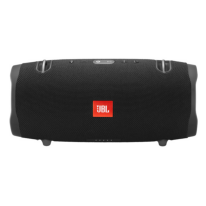

Такие рекомендации


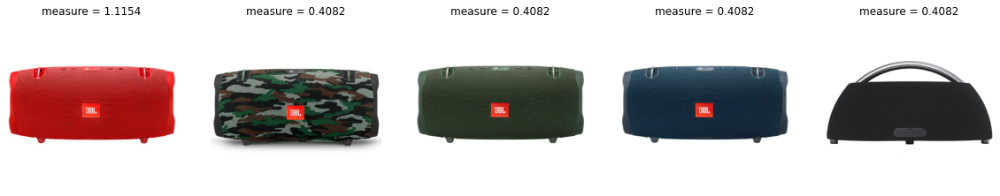

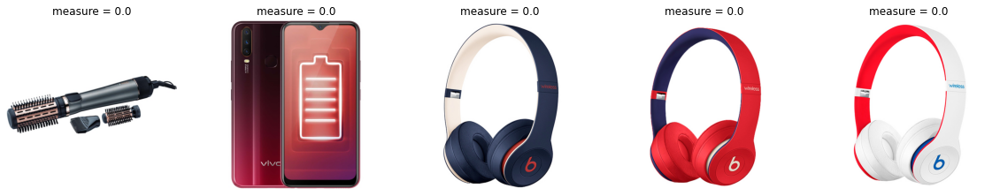

In [85]:
clb.user_based(0)

Для таких товаров


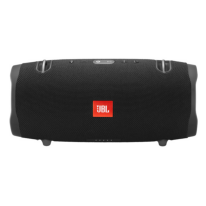

Такие рекомендации


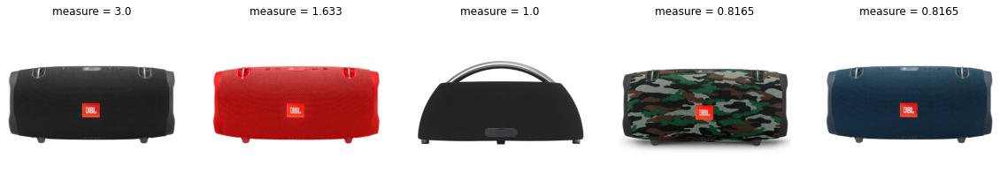

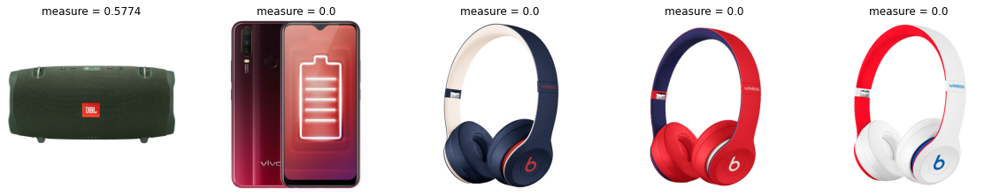

In [86]:
clb.item_based(0)

Для таких товаров


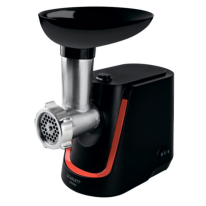

Такие рекомендации


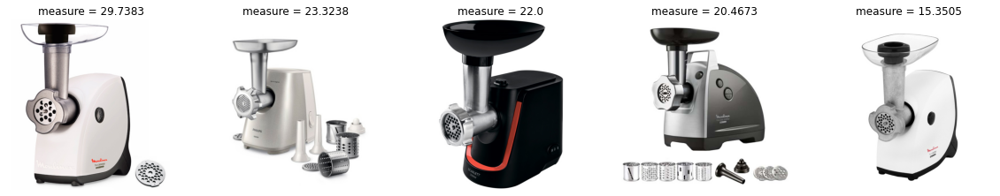

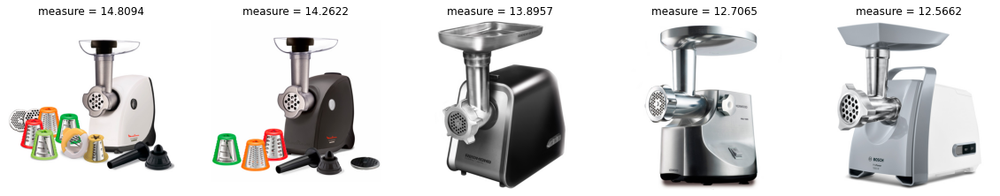

In [87]:
clb.item_based(12)

Для таких товаров


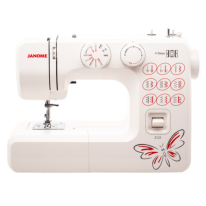

Такие рекомендации


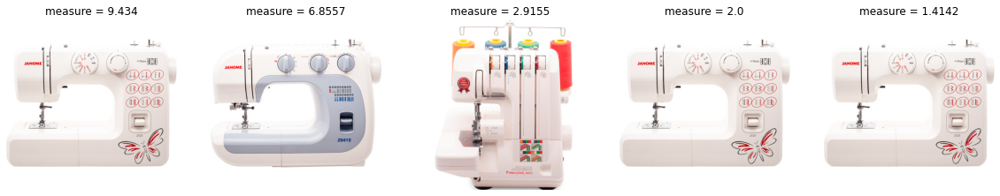

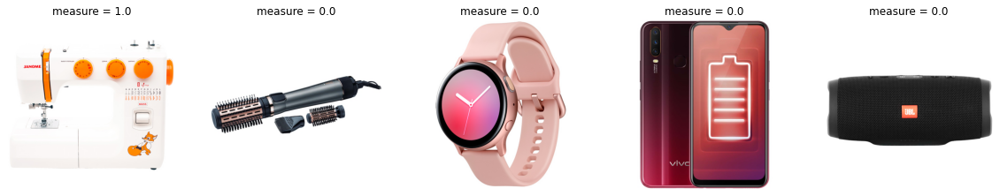

In [88]:
clb.item_based(31211)

Для таких товаров


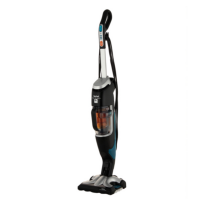

Такие рекомендации


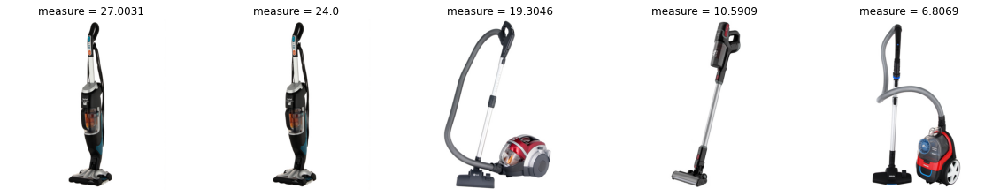

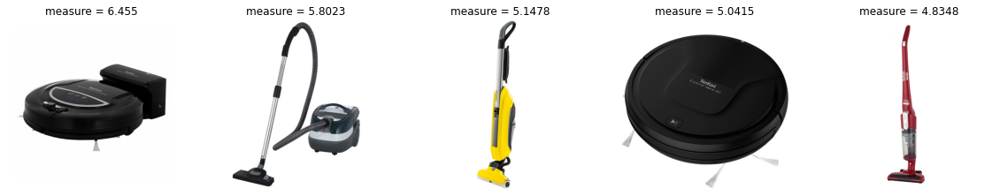

In [89]:
clb.item_based(2556)

Для таких товаров


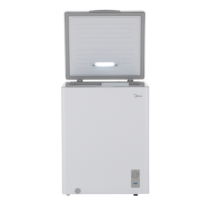

Такие рекомендации


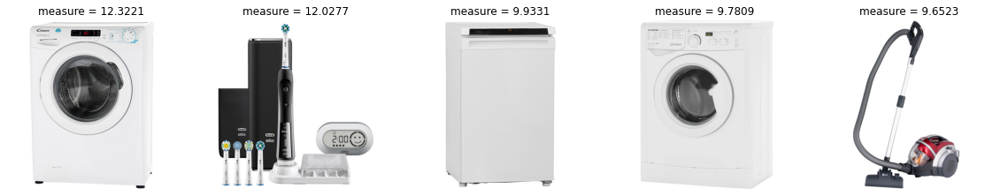

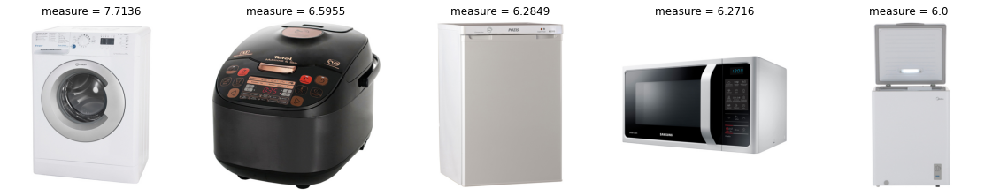

In [90]:
clb.item_based(404)

Для таких товаров


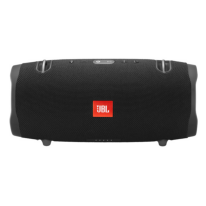

Такие рекомендации


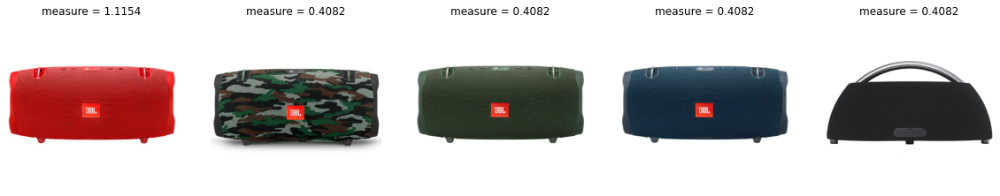

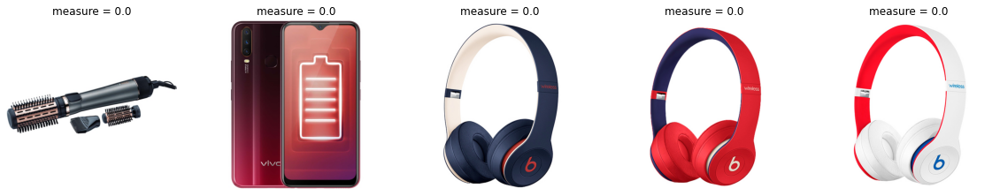

In [91]:
clb.user_based(0)

Для таких товаров


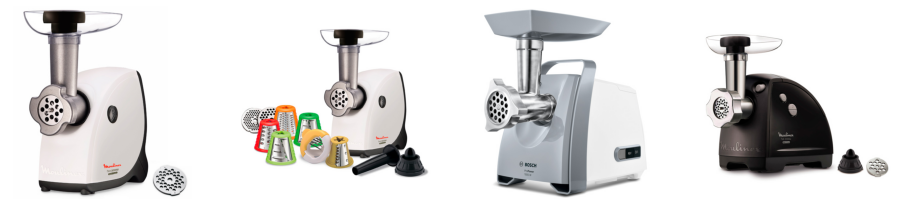

Такие рекомендации


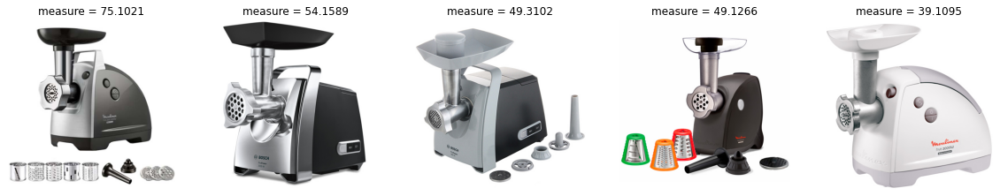

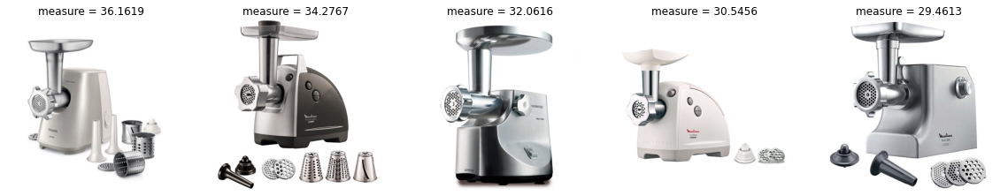

In [92]:
clb.user_based(404)

Для таких товаров


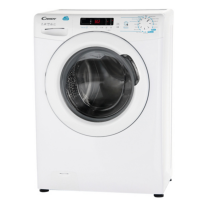

Такие рекомендации


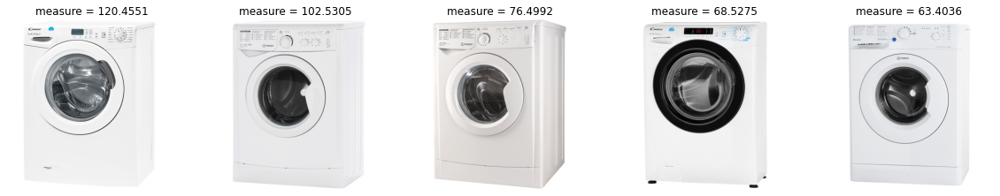

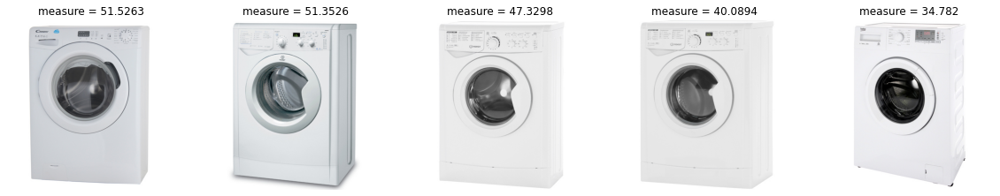

In [93]:
clb.user_based(12345)

Для таких товаров


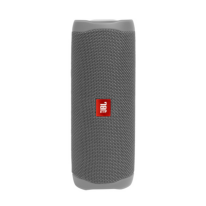

Такие рекомендации


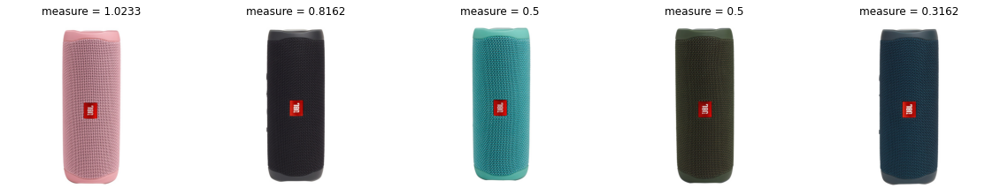

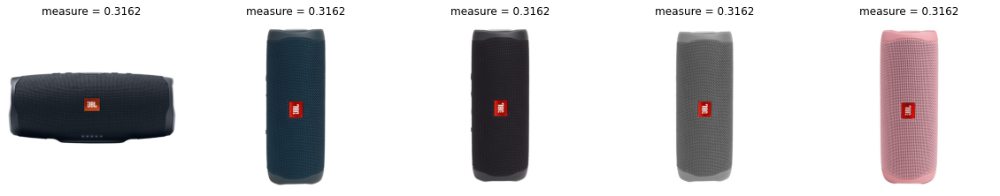

In [94]:
clb.user_based(123456)

Для таких товаров


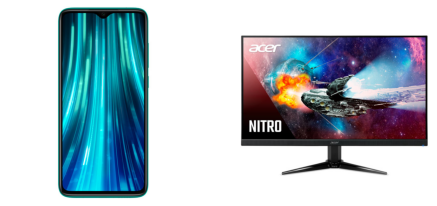

Такие рекомендации


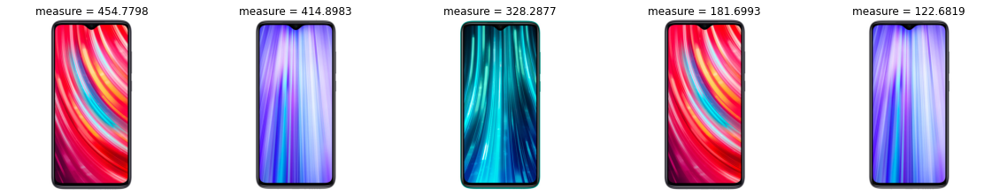

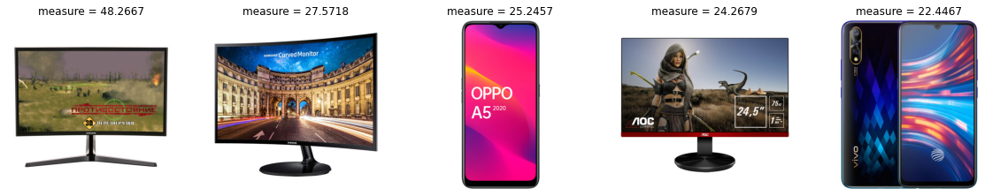

In [95]:
clb.user_based(34434)

Для таких товаров


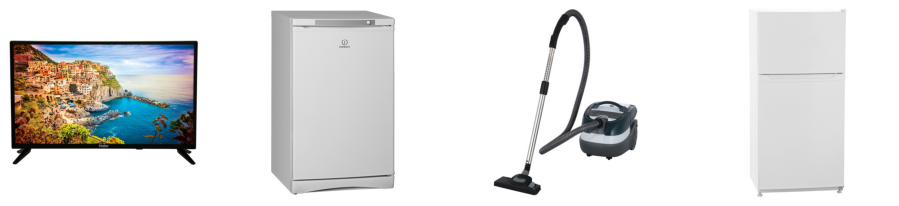

Такие рекомендации


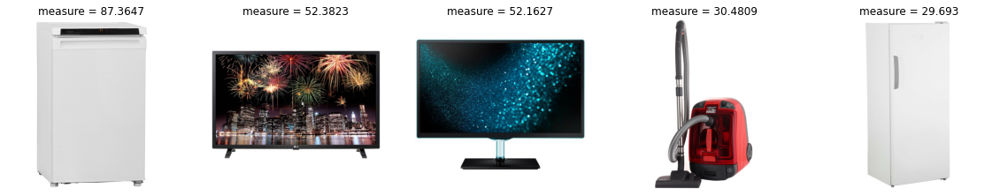

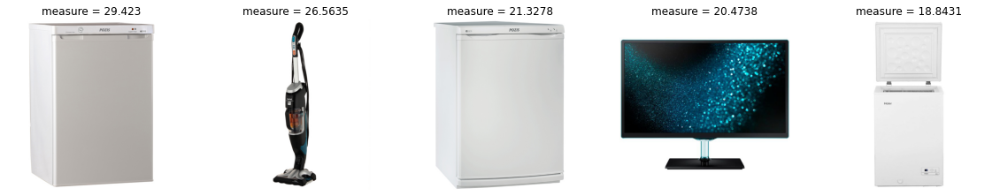

In [96]:
clb.user_based(3333)

Для таких товаров


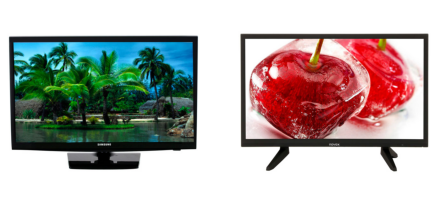

Такие рекомендации


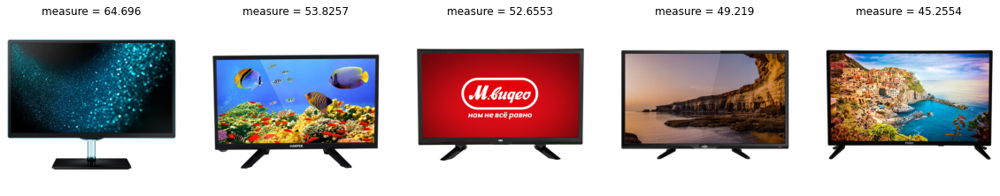

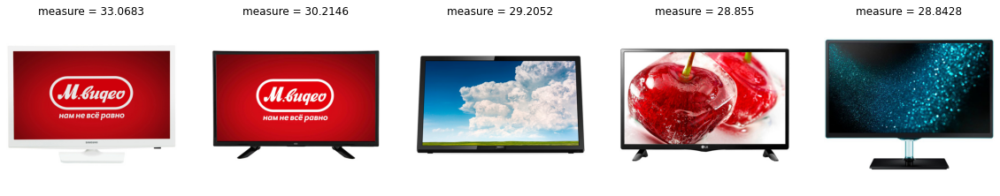

In [97]:
clb.user_based(5555)

Для таких товаров


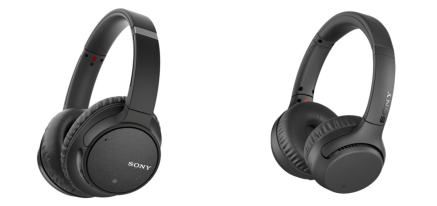

Такие рекомендации


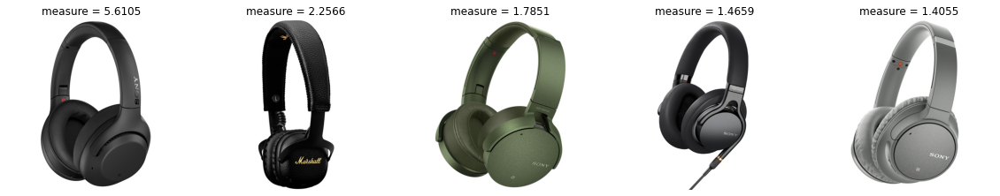

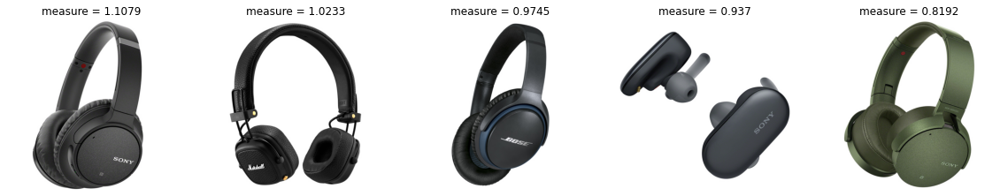

In [98]:
clb.user_based(77777)

Для таких товаров


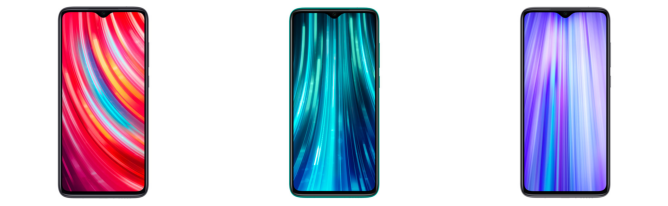

Такие рекомендации


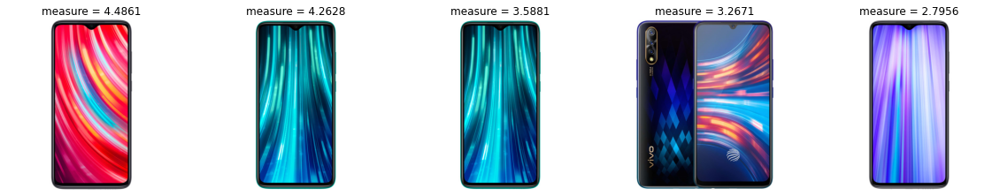

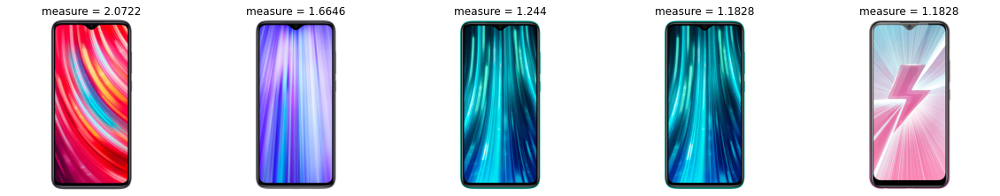

In [99]:
clb.user_based(5)

Для таких товаров


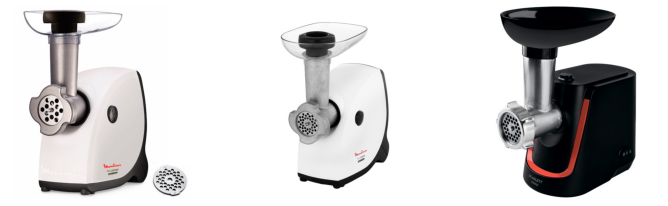

Такие рекомендации


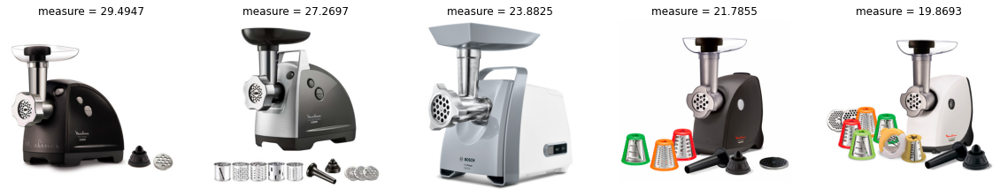

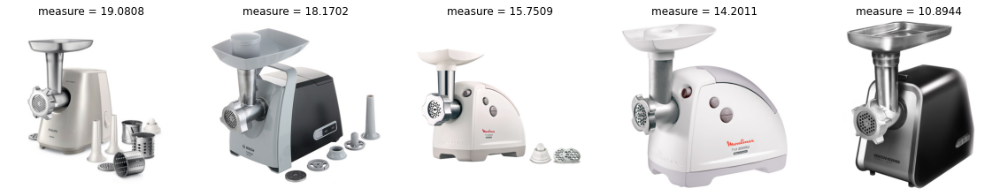

In [100]:
clb.user_based(323)

# Matrix Factorization

In [101]:
class MatrixFactorization():
    
    def __init__(self, interactions, k):
        interactions["product_id"] = interactions["product_id"].astype(int)
        self.k = k
        self.content_dict = {}
        for i, j in interactions[["product_id", "picture_url"]].drop_duplicates().values:
            self.content_dict[i] = j
        df_weights = pd.DataFrame({"page_type": ["PRODUCT", "CART", "PURCHASE"],
                                   'weight': [1, 1, 1]})
        weighted = interactions.merge(df_weights, on="page_type")\
                          .groupby(["vid", "product_id", "picture_url"])["weight"]\
                          .sum()\
                          .reset_index()
        weighted["weight"] = (weighted["weight"] > 0).astype(int)
        self.csr_rates = coo_matrix((weighted["weight"], (weighted["vid"], weighted["product_id"])), 
                            shape=(len(set(weighted["vid"])), len(set(weighted["product_id"]))))
        
    def MF(self):
        U, S, V = svds(self.csr_rates.astype(float), k=self.k)
        self.user_embs = U
        self.items_embs = V.T
        
    def LightFM(self):
        self.model = LightFM(loss='warp', no_components=100, learning_rate=0.03, learning_schedule="adadelta")
        self.model.fit(self.csr_rates, epochs=5, num_threads=40, verbose=True)
        self.user_feature_bias, self.user_feature_embeddings = self.model.get_user_representations()
        self.item_feature_bias, self.items_embs = self.model.get_item_representations()

    def get_rec(self, i):
        metrics = cosine_similarity([self.items_embs[i]], self.items_embs)
        print(u"Для товара")
        rec_imaging([i], self.content_dict)
        print(u"Такие рекомендации")
        rec_imaging(np.argsort(-metrics)[0][1:11], self.content_dict, -np.round(np.sort(-metrics)[0][1:11], 4))

In [102]:
simple_svd = MatrixFactorization(Int, 30)
simple_svd.MF()

Для товара


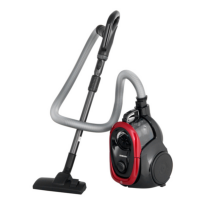

Такие рекомендации


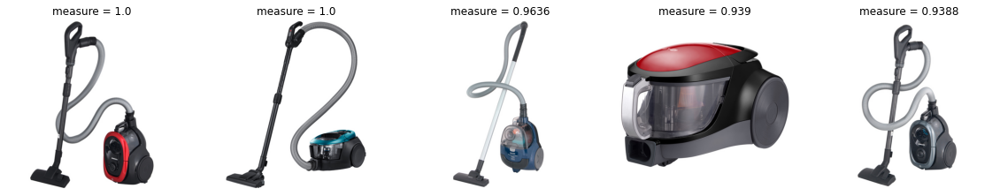

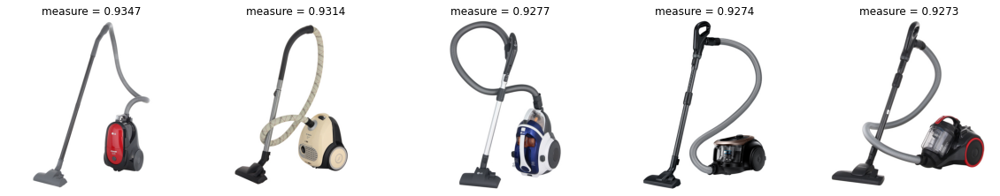

In [103]:
simple_svd.get_rec(122)

Для товара


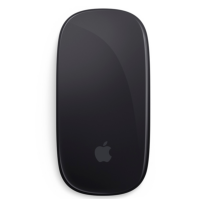

Такие рекомендации


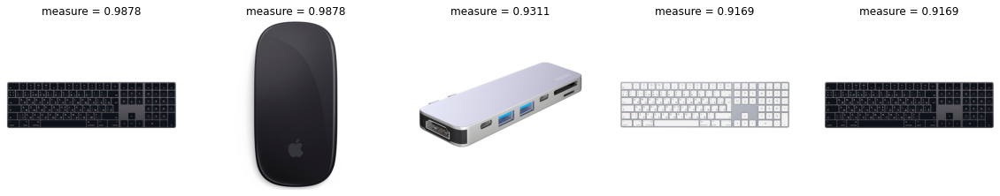

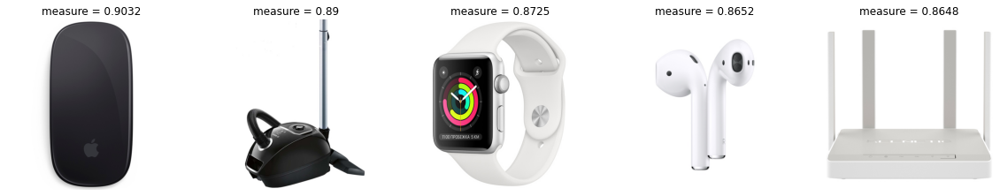

In [104]:
simple_svd.get_rec(402)

Для товара


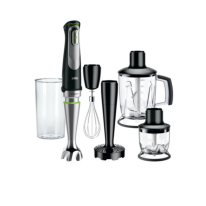

Такие рекомендации


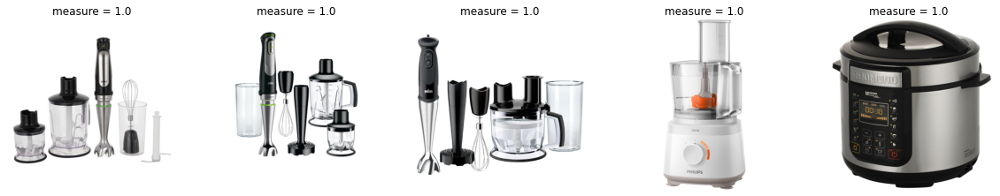

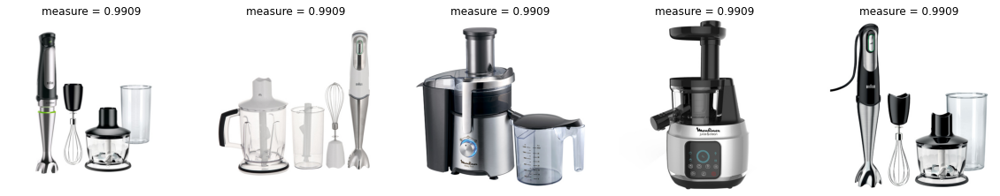

In [105]:
simple_svd.get_rec(10022)

Для товара


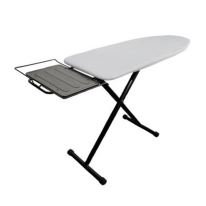

Такие рекомендации


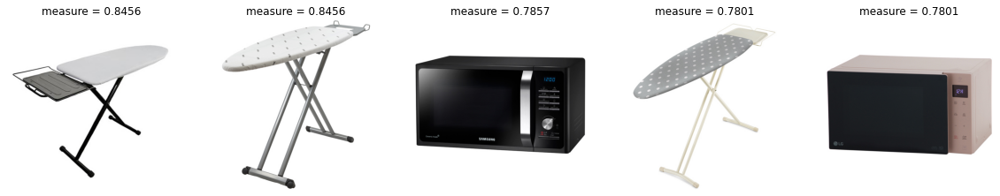

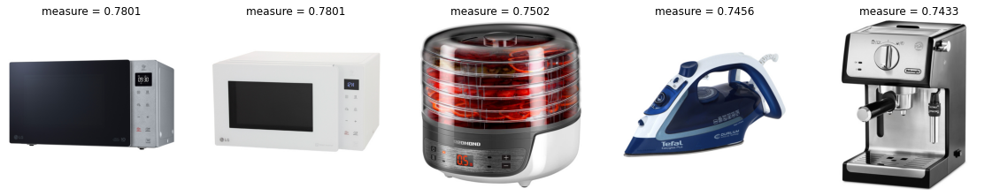

In [106]:
simple_svd.get_rec(406)

# LightFM

In [107]:
mf = MatrixFactorization(Int, 300)
mf.LightFM()

Epoch: 100%|██████████| 5/5 [00:09<00:00,  1.82s/it]


Для товара


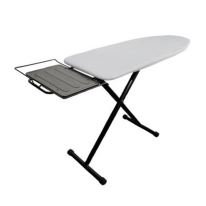

Такие рекомендации


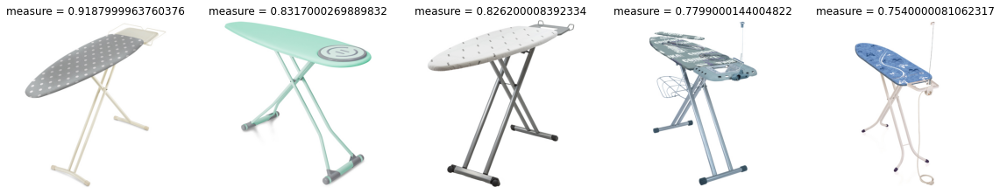

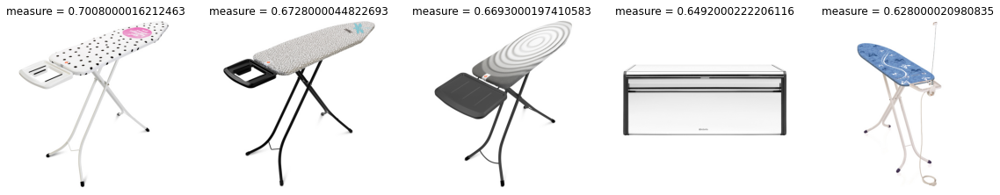

In [108]:
mf.get_rec(406)

Для товара


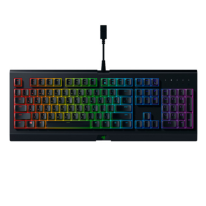

Такие рекомендации


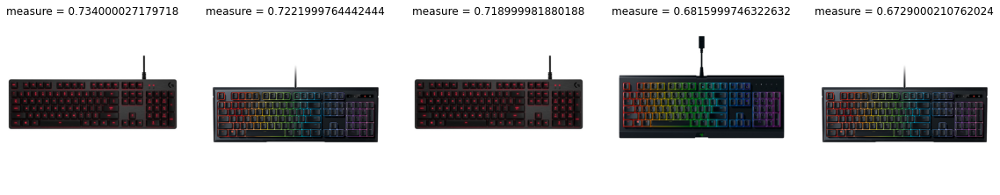

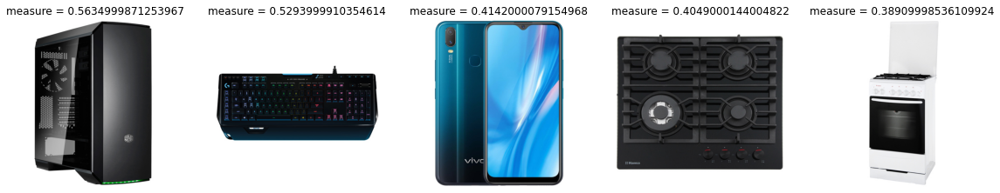

In [109]:
mf.get_rec(1234)

# ALS

$\min\limits_{q^*,p^*}\sum\limits_{u,i}(r_{ui} - q_i^Tp_u)^2 + \lambda(||q_i||^2 + ||p_u||^2)$

In [110]:
LATENT_SIZE = 100

lambda_p = 0.2
lambda_q = 0.01

Посчитаем количество пользователей и товаров

In [111]:
n_users = Int["vid"].value_counts().shape[0]
n_items = Int["product_id"].value_counts().shape[0]

Инициализируем латентные представления для пользователей и товаров

In [112]:
p = 0.1 * np.random.random((n_users, LATENT_SIZE))
q = 0.1 * np.random.random((n_items, LATENT_SIZE))

In [113]:
from collections import defaultdict

In [114]:
df_weights = pd.DataFrame({"page_type": ["PRODUCT", "CART", "PURCHASE"],
                           'weight': [1, 5, 20]})
weighted = Int.merge(df_weights, on="page_type")\
                  .groupby(["vid", "product_id", "picture_url"])["weight"]\
                  .max()\
                  .reset_index()

In [115]:
weighted.head()

,vid,product_id,picture_url,weight
0,0,0,https://img.mvideo.ru/Pdb/10018823b.jpg,1
1,1,0,https://img.mvideo.ru/Pdb/10018823b.jpg,1
2,1,42341,https://img.mvideo.ru/Pdb/10020865b.jpg,1
3,2,0,https://img.mvideo.ru/Pdb/10018823b.jpg,1
4,2,37522,https://img.mvideo.ru/Pdb/10018824b.jpg,1


Составим словарь взаимодействий по товару

In [116]:
train_by_item = defaultdict(list)
for u, i, _, r in weighted.values:
    train_by_item[i].append((u, r))

Составим словарь взаимодействий по пользователю

In [117]:
train_by_user = defaultdict(list)
for u, i, _, r in weighted.values:
    train_by_user[u].append((i, r))

Теперь составим матрицу $P$ из векторов $p_u$ и матрицу Q из векторов $q_i$. Матрицей $Q[u] \in \mathbb{R}^{n_u \times K}$ будем обозначать подматрицу матрицы $Q$ только для товаров, оцененных пользователем $u$, где $n_u$ - количество оценок пользователя $u$.

Шаг перенастройки $p_u$ при фиксированной матрице $Q$ будет выглядеть следующим образом:


$$
A_u = Q[u]^TQ[u]
$$

$$
d_u = Q[u]^Tr_u
$$

$$
p_u = (\lambda_pI + A_u)^{-1}d_u
$$


In [118]:
def compute_p(p, q, train_by_user):
    for u, rated in train_by_user.items():
        rated_items = [i for i, _ in rated]
        Au = q[rated_items].T.dot(q[rated_items])
        ratings = [i for _, i in rated]
        du = q[rated_items].T.dot(ratings)
        p[u] = np.linalg.inv(lambda_p * np.eye(Au.shape[0]) + Au).dot(du)
    return p

Шаг для перенастройки $q_i$ при фиксированной матрице $P$ будет считаться аналогично

In [119]:
def compute_q(p, q, train_by_item):
    for i, rated in train_by_item.items():
        rated_users = [u for u, _ in rated]
        Au = p[rated_users].T.dot(p[rated_users])
        ratings = [u for _, u in rated]
        du = p[rated_users].T.dot(ratings)
        q[i] = np.linalg.inv(lambda_q * np.eye(Au.shape[0]) + Au).dot(du)
    return q

In [120]:
from tqdm.notebook import tqdm_notebook

In [121]:
for i in tqdm_notebook(range(20)):
    p = compute_p(p, q, train_by_user)
    q = compute_q(p, q, train_by_item)

In [122]:
np.save("q.npy", q)

In [123]:
q = np.load("q.npy")

In [124]:
product_id_to_url = {}
for i in Int[["product_id", "picture_url"]].drop_duplicates().values:
    product_id_to_url[i[0]] = i[1]

In [125]:
def get_rec_I2I(q, i):
    metrics = cosine_similarity([q[i]], q)
    print(u"Для товара")
    rec_imaging([i], product_id_to_url)
    print(u"Такие рекомендации")
    rec_imaging(np.argsort(metrics)[0][::-1][1:6], product_id_to_url, np.sort(metrics)[0][::-1][1:6])

Для товара


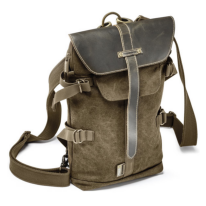

Такие рекомендации


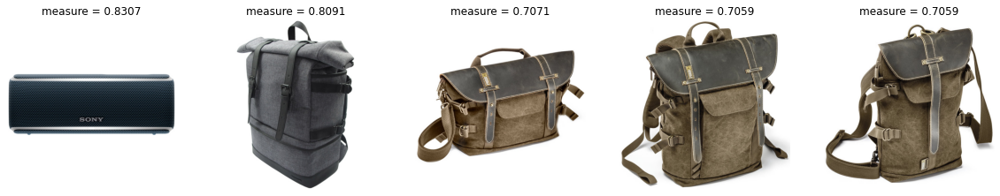

In [126]:
get_rec_I2I(q, 9343)

Для товара


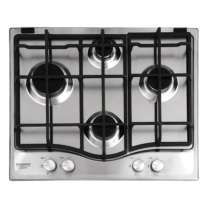

Такие рекомендации


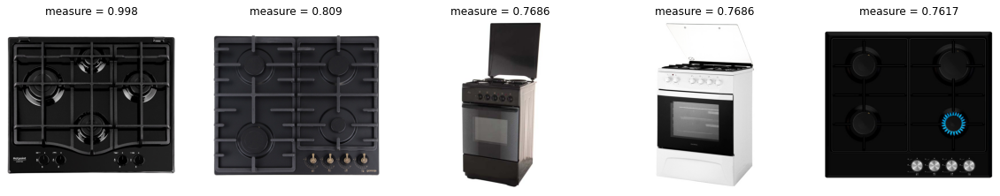

In [127]:
get_rec_I2I(q, 50000)

Для товара


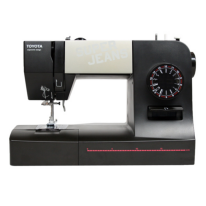

Такие рекомендации


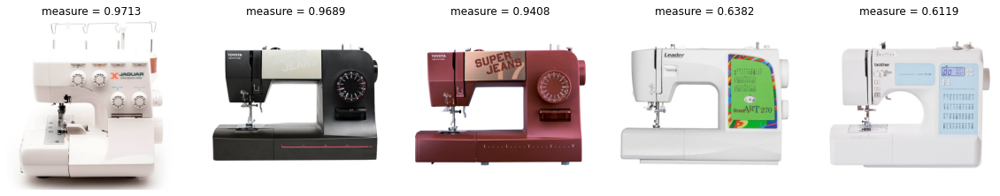

In [128]:
get_rec_I2I(q, 6593)

Для товара


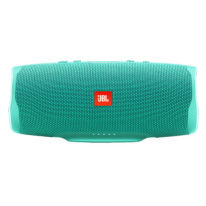

Такие рекомендации


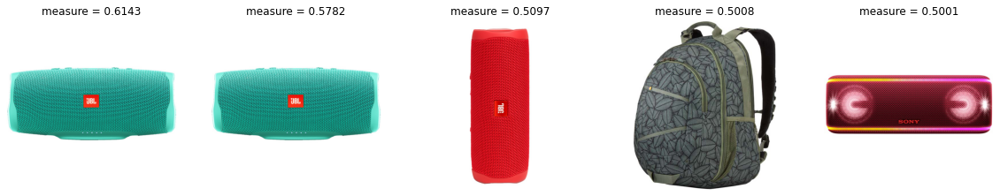

In [129]:
get_rec_I2I(q, 1000)

# Домашнее задание

Data contains the book rating information. Ratings (Book-Rating) are either explicit, expressed on a scale from 1-10 (higher values denoting higher appreciation), or implicit, expressed by 0.

### 1. Реализовать персональный топ  - принимает на вход возраст и локацию, на выходе персональный топ   - 1 балл

Персональный топ - это топ товаров по похожим возрасту/интересам/локации. Как сделать? Разбить на сегменты по выбраным признакам. Топ делать по книгам с хорошим средним рейтингом.

### 2. На основе метода кластеризации похожих пользователей построить рекомендации (Слайд 25) - 2 балла

Нужно топ-10 рекомендаций с самой высокой оценкой. Считаем среднюю оценку для каждой книги по кластеру и выводим топ-10 книг.

### 3. Применить методы расмотренные на лекции (Совстречаемость - 2 балл, Content-based - 1 балл, Коллаборативная фильтрация - 3 балла , Матричная Факторизация - 1 балл) - 7 баллов

В совстречаемости также учитывать оценки. Вес пары книг встретившихся у пользователя - полусумма их оценок

Коллаборативную фильтрацию реализовывать как на слайде 50 презентации, посоветовав каждому пользователю топ-10 книг с самой высокой оценкой. Сделать рекомендации User-based и Item-based и сравнить.

Если совсем сложно - можно сделать как в семинарской части, поставив оценку "0", если рейтинг < 5 и "1" - в противном случае. Тогда максимум за это - 1 балл.

Для Content-based, Коллаборативной фильтрации, Матричной Факторизации реализовать U2I и I2I рекомендации

### Примечание:

Так как пользователей много - можно зафиксировать несколько произвольных и для них уже составлять рекомендации

Работоспособность I2I можно проверять на известных книгах (Гарри Поттер, Властелин Колец, Интервью с вампиром, Код-Да-Винчи, Маленький Принц)

Рейтинг книг обязательно нужно учитывать

Не забываем также предобработать данные - выкинуть выбросы-пользователей и выбросы-книги.

# Жесткий дедлайн 12 мая

Выводить в качестве рекомендаций лучше названия книг, картинки (если они есть) и соответствующие метрики близости.

In [498]:
from sklearn.preprocessing import LabelEncoder

In [736]:
books = pd.read_csv("./HW_files/BX-Books.csv")

/opt/anaconda3/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3146: DtypeWarning: Columns (3) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


In [737]:
interactions = pd.read_csv("./HW_files/BX-Book-Ratings.csv", sep=";", encoding = "ISO-8859-1")

In [738]:
interactions.shape

(1149780, 3)

In [739]:
interactions = interactions[interactions["Book-Rating"] != 0]

In [740]:
interactions.shape

(433671, 3)

In [741]:
interactions

,User-ID,ISBN,Book-Rating
1,276726,0155061224,5
3,276729,052165615X,3
4,276729,0521795028,6
6,276736,3257224281,8
7,276737,0600570967,6
...,...,...,...
1149773,276704,0806917695,5
1149775,276704,1563526298,9
1149777,276709,0515107662,10
1149778,276721,0590442449,10


In [742]:
users

,User-ID,Location,Age
0,34.546147,34.54614694277674,35
1,2.000000,"stockton, california, usa",18
2,34.546147,34.54614694277674,35
3,4.000000,"porto, v.n.gaia, portugal",17
4,34.546147,34.54614694277674,35
...,...,...,...
278853,34.546147,34.54614694277674,35
278854,278855.000000,"tacoma, washington, united kingdom",52
278855,34.546147,34.54614694277674,35
278856,34.546147,34.54614694277674,35


In [743]:
books

,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher,Image-URL-S,Image-URL-M,Image-URL-L
0,0195153448,Classical Mythology,Mark P. O. Morford,2002,Oxford University Press,http://images.amazon.com/images/P/0195153448.0...,http://images.amazon.com/images/P/0195153448.0...,http://images.amazon.com/images/P/0195153448.0...
1,0002005018,Clara Callan,Richard Bruce Wright,2001,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...
2,0060973129,Decision in Normandy,Carlo D'Este,1991,HarperPerennial,http://images.amazon.com/images/P/0060973129.0...,http://images.amazon.com/images/P/0060973129.0...,http://images.amazon.com/images/P/0060973129.0...
3,0374157065,Flu: The Story of the Great Influenza Pandemic...,Gina Bari Kolata,1999,Farrar Straus Giroux,http://images.amazon.com/images/P/0374157065.0...,http://images.amazon.com/images/P/0374157065.0...,http://images.amazon.com/images/P/0374157065.0...
4,0393045218,The Mummies of Urumchi,E. J. W. Barber,1999,W. W. Norton &amp; Company,http://images.amazon.com/images/P/0393045218.0...,http://images.amazon.com/images/P/0393045218.0...,http://images.amazon.com/images/P/0393045218.0...
...,...,...,...,...,...,...,...,...
271355,0440400988,There's a Bat in Bunk Five,Paula Danziger,1988,Random House Childrens Pub (Mm),http://images.amazon.com/images/P/0440400988.0...,http://images.amazon.com/images/P/0440400988.0...,http://images.amazon.com/images/P/0440400988.0...
271356,0525447644,From One to One Hundred,Teri Sloat,1991,Dutton Books,http://images.amazon.com/images/P/0525447644.0...,http://images.amazon.com/images/P/0525447644.0...,http://images.amazon.com/images/P/0525447644.0...
271357,006008667X,Lily Dale : The True Story of the Town that Ta...,Christine Wicker,2004,HarperSanFrancisco,http://images.amazon.com/images/P/006008667X.0...,http://images.amazon.com/images/P/006008667X.0...,http://images.amazon.com/images/P/006008667X.0...
271358,0192126040,Republic (World's Classics),Plato,1996,Oxford University Press,http://images.amazon.com/images/P/0192126040.0...,http://images.amazon.com/images/P/0192126040.0...,http://images.amazon.com/images/P/0192126040.0...


In [744]:
books_meets = interactions.groupby("ISBN")["User-ID"].count().reset_index().rename(columns={"User-ID": "user_num"})

In [745]:
user_meets = interactions.groupby("User-ID")["ISBN"].count().reset_index().rename(columns={"ISBN": "books_num"})

In [746]:
user_meets

,User-ID,books_num
0,8,7
1,9,1
2,10,1
3,12,1
4,14,3
...,...,...
77800,278846,1
77801,278849,1
77802,278851,14
77803,278852,1


In [747]:
interactions = interactions.merge(books_meets, on=["ISBN"]).merge(user_meets, on=["User-ID"])

In [748]:
interactions = interactions[(interactions["user_num"] > 5) & 
                            (interactions["books_num"] > 5) &
                            (interactions["books_num"] < 200)]

In [754]:
users = pd.read_csv('./HW_files/BX-Users.csv', delimiter=';', encoding = 'ISO-8859-1')

In [755]:
users

,User-ID,Location,Age
0,1,"nyc, new york, usa",NaN
1,2,"stockton, california, usa",18.0
2,3,"moscow, yukon territory, russia",NaN
3,4,"porto, v.n.gaia, portugal",17.0
4,5,"farnborough, hants, united kingdom",NaN
...,...,...,...
278853,278854,"portland, oregon, usa",NaN
278854,278855,"tacoma, washington, united kingdom",50.0
278855,278856,"brampton, ontario, canada",NaN
278856,278857,"knoxville, tennessee, usa",NaN


Оставим только возраст у пользователей младше 90. Считаем, что все остальное выбросы и заменим на Nan

(array([4.4314e+04, 9.3316e+04, 2.9212e+04, 8.7500e+02, 3.0100e+02,
        2.8000e+01, 1.5000e+01, 5.0000e+00, 1.8000e+01, 1.2000e+01]),
 array([  0. ,  24.4,  48.8,  73.2,  97.6, 122. , 146.4, 170.8, 195.2,
        219.6, 244. ]),
 <BarContainer object of 10 artists>)

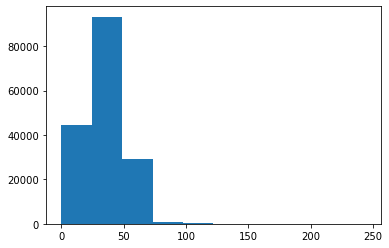

In [756]:
plt.hist(users['Age'])

In [758]:
le_Age = LabelEncoder()

users.loc[users['Age'] > 90, 'Age'] = users['Age'].mean()
users['Age'].fillna(users['Age'].mean(), inplace=True)

le_Age.fit(users['Age'])
users['Age'] = le_Age.transform(users['Age'])

Оставим в столбце `Location` только страну:

In [759]:
users

,User-ID,Location,Age
0,1,"nyc, new york, usa",35
1,2,"stockton, california, usa",18
2,3,"moscow, yukon territory, russia",35
3,4,"porto, v.n.gaia, portugal",17
4,5,"farnborough, hants, united kingdom",35
...,...,...,...
278853,278854,"portland, oregon, usa",35
278854,278855,"tacoma, washington, united kingdom",52
278855,278856,"brampton, ontario, canada",35
278856,278857,"knoxville, tennessee, usa",35


In [760]:
users['Location'] = users['Location'].astype(str)

In [762]:
locations = users['Location'].str.replace(' ', '').str.split(',')
# locations = list(filter(lambda x: len(x) == 3, locations))
# locations = np.array(list(map(lambda l: ' '.join(l[1:]) if l[1] != 'n/a' else l[2], locations)))
locations = np.array(list(map(lambda l: l[-1], locations)))
np.unique(locations).shape

(702,)

In [763]:
users.Location

0                         nyc, new york, usa
1                  stockton, california, usa
2            moscow, yukon territory, russia
3                  porto, v.n.gaia, portugal
4         farnborough, hants, united kingdom
                         ...                
278853                 portland, oregon, usa
278854    tacoma, washington, united kingdom
278855             brampton, ontario, canada
278856             knoxville, tennessee, usa
278857                  dublin, n/a, ireland
Name: Location, Length: 278858, dtype: object

In [764]:
le_location = LabelEncoder()
le_location.fit(locations)
users['Location'] = le_location.transform(locations)

In [765]:
interactions = interactions.merge(users[["User-ID", "Location", "Age"]], on=["User-ID"])

In [766]:
interactions = interactions.merge(books[["ISBN", "Image-URL-M", "Book-Title"]].rename(
    columns={"Image-URL-M": "picture_url"}), on=["ISBN"])

In [767]:
interactions["product_id"] = le.fit_transform(interactions["ISBN"])
interactions["vid"] = le.fit_transform(interactions["User-ID"])

In [768]:
interactions.head()

,User-ID,ISBN,Book-Rating,user_num,books_num,Location,Age,picture_url,Book-Title,product_id,vid
0,86583,3404139178,9,8,18,240,31,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,10397,3445
1,132500,3404139178,10,8,43,0,29,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,10397,5248
2,66483,3404139178,10,8,83,240,16,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,10397,2622
3,276866,3404139178,9,8,11,240,27,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,10397,10887
4,106534,3404139178,6,8,6,580,18,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,10397,4228


In [912]:
csr_rates = coo_matrix((interactions["Book-Rating"], (interactions["vid"], interactions["product_id"])), 
                            shape=(len(set(interactions["vid"])), len(set(interactions["product_id"]))))

### Ищем id нужных книг

In [770]:
for i, j in interactions[["product_id", "Book-Title"]].drop_duplicates().values:
    if "The Little Prince" in j:
        print("idx:", i, "\tBook Title:", j)

idx: 1264 	Book Title: The Little Prince
idx: 1265 	Book Title: The Little Prince
idx: 1242 	Book Title: The Little Prince
idx: 1212 	Book Title: The Little Prince
idx: 10195 	Book Title: The Little Prince (Wordsworth Collection)


### Персональный топ

In [809]:
class Personal_top():
    def __init__(self, age, location, Int):
        self.product_id_to_url = {}
        self.product_id_to_title = {}
        self.product_id_to_rating = {}
        for i in Int[["product_id", "picture_url"]].drop_duplicates().values:
            self.product_id_to_url[i[0]] = i[1]
        for i in Int[["product_id", "Book-Title"]].drop_duplicates().values:
            self.product_id_to_title[i[0]] = i[1]
        for i in Int[["product_id", "Book-Rating"]].drop_duplicates().values:
            self.product_id_to_rating[i[0]] = i[1]
        self.interactions = Int.copy()
        self.interactions['Age'] = le_Age.inverse_transform(self.interactions['Age'])
        self.interactions['Location'] = le_location.inverse_transform(self.interactions['Location'])
        self.age = age
        self.location = location
    def personal_top(self):
        slace = self.interactions[\
            (self.interactions['Age'] == self.age) & (self.interactions['Location'] == self.location)]
        avg_ratings = slace.groupby("product_id")["Book-Rating"].mean().reset_index()\
            .rename(columns={"Book-Rating": "Average-Book-Rating"}).merge(self.interactions, on=["product_id"])
        avg_ratings = avg_ratings[["product_id", "Average-Book-Rating"]].drop_duplicates()
        return avg_ratings.sort_values("Average-Book-Rating", ascending=False).head(10)
    def show_rec(self):
        print(u"Такие рекомендации")
        recs = self.personal_top()
        for k in recs.index:
            rec_imaging([int(recs["product_id"][k])], self.product_id_to_url,
                         [int(recs["Average-Book-Rating"][k])])
            print(self.product_id_to_title[int(recs["product_id"][k])])
            print(int(recs["product_id"][k]))
    

In [933]:
interactions[["vid"]].drop_duplicates().merge(interactions[["vid", "Book-Rating"]], on=["vid"])

,vid,Book-Rating
0,3445,9
1,3445,8
2,3445,7
3,5248,10
4,5248,8
...,...,...
110514,879,8
110515,7498,7
110516,8112,9
110517,8754,8


Такие рекомендации


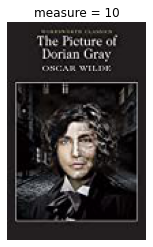

Picture of Dorian Gray (Wordsworth Classics)
10168


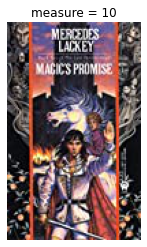

Magic's Promise (The Last Herald-Mage Series, Book 2)
9579


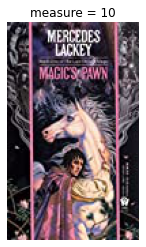

Magic's Pawn (The Last Herald-Mage Series, Book 1)
9572


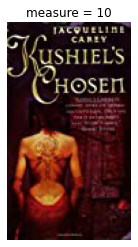

Kushiel's Chosen (Kushiel's Legacy)
8790


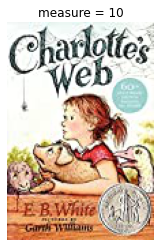

Charlotte's Web
185


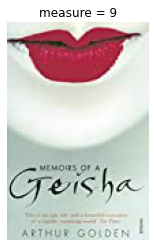

Memoirs of a Geisha Uk
797


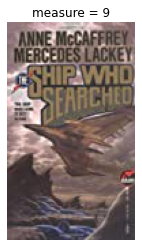

The Ship Who Searched
7650


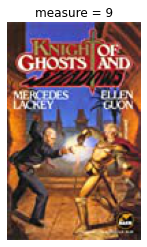

Knights of Ghosts &amp; Shadows
7630


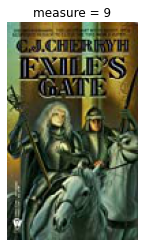

Exile's Gate (Morgaine Saga, Book 4)
9571


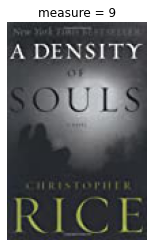

A Density of Souls
8955


In [817]:
personal_top = Personal_top(20, 'unitedkingdom', interactions)
personal_top.show_rec()

### Рекомендации на основе кластеризации пользователей

In [1011]:
from sklearn.cluster import DBSCAN
class UserCluster():
    def __init__(self, csr_rates, Int):
        self.product_id_to_url = {}
        self.product_id_to_title = {}
        self.product_id_to_rating = {}
        for i in Int[["product_id", "picture_url"]].drop_duplicates().values:
            self.product_id_to_url[i[0]] = i[1]
        for i in Int[["product_id", "Book-Title"]].drop_duplicates().values:
            self.product_id_to_title[i[0]] = i[1]
        for i in Int[["product_id", "Book-Rating"]].drop_duplicates().values:
            self.product_id_to_rating[i[0]] = i[1]
        self.csr_rates = csr_rates
        self.int = Int[["vid", 'product_id', 'Book-Rating', 'Book-Title']].drop_duplicates()
        self.users = Int[["vid"]].drop_duplicates()
        self.items = Int[["product_id"]].drop_duplicates()
        
    def get_clusters(self):
        db = DBSCAN(eps=0.6, min_samples=20, metric='cosine').fit(self.csr_rates)
        labels = db.labels_
        self.users['labels'] = labels
        
    def get_mesure(self, user, item):
        label = self.users[self.users['vid'] == user]['labels'].values[0]
        _users = self.users[self.users['labels'] == label]['vid']
        Sum = 0
        count = 0
        for u in _users.values:
            rating = self.int[(self.int['vid'] == u) & (self.int['product_id'] == item[0])]['Book-Rating']
            if not rating.empty:
                count += 1
                Sum += rating.values
        
        return 0 if count == 0 else Sum/count
    
    def get_rec(self, user):
        self.get_clusters()
        recs = {}
        for i in self.items.values:
            recs[i[0]] = self.get_mesure(user, i)
        recs_sorted = sorted(recs.items(), key = lambda kv:(kv[1], kv[0]))
        for k in range(len(recs_sorted) - 10, len(recs_sorted)):
            rec_imaging([recs_sorted[k][0]], self.product_id_to_url, [recs_sorted[k][1]])
            print(self.int[self.int['product_id'] == recs_sorted[k][0]]['Book-Title'].drop_duplicates().values)
   

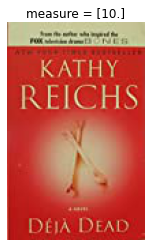

['Deja Dead']


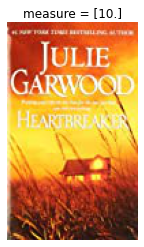

['Heartbreaker']


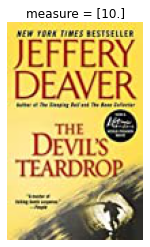

["The Devil's Teardrop"]


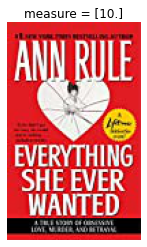

['EVERYTHING SHE EVER WANTED']


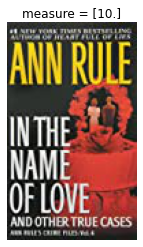

["In the Name of Love : Ann Rule's Crime Files Volume 4 (Ann Rule's Crime Files)"]


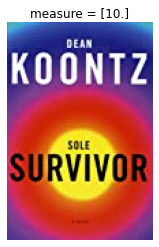

['Sole Survivor']


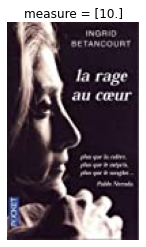

['La Rage au coeur']


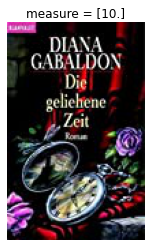

['Die geliehene Zeit.']


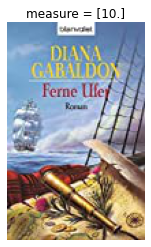

['Ferne Ufer. Der 3. Band der groÃ?Â?en Highland- Saga.']


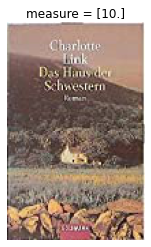

['Das Haus der Schwestern.']


In [1012]:
uc = UserCluster(csr_rates, interactions)
uc.get_rec(5446)


In [961]:
uc.users[uc.users['labels'] == 17]

,vid,labels
11,5446,17
1786,3602,17
5222,7939,17
6878,7867,17
7477,7004,17
7674,4860,17
8280,8406,17
10584,7345,17
11041,7310,17
19819,3771,17


### Совстречаемость
Чуть переделанный пример из лекции

In [637]:
class Сoocurrency():
    def __init__(self, Int):
        # Создаём словарь для того, чтобы по product_id возвращать url товара
        self.product_id_to_url = {}
        self.product_id_to_title = {}
        self.product_id_to_rating = {}
        for i in Int[["product_id", "picture_url"]].drop_duplicates().values:
            self.product_id_to_url[i[0]] = i[1]
        for i in Int[["product_id", "Book-Title"]].drop_duplicates().values:
            self.product_id_to_title[i[0]] = i[1]
        for i in Int[["product_id", "Book-Rating"]].drop_duplicates().values:
            self.product_id_to_rating[i[0]] = i[1]
        self.interactions = Int
    
    def coocurrency_count(self):
        Int = self.interactions[["vid", "product_id"]].drop_duplicates()
        # Для каждого пользователя собираем товары, с которыми он взамиодействовал
        user_products = Int.groupby(["vid"])["product_id"].apply(list).reset_index()
        # Считаем число товаров, с которыми взаимодействовал каждый пользователь и записываем в колонку prod_num
        product_num = [len(i) for i in user_products["product_id"]]
        user_products["prod_num"] = product_num
        # Фильтруем пользователей, взаимодействовавших с одним товаром
        user_products = user_products[user_products["prod_num"] > 1]
        
        # Заводим словарь под товары
        cooc = {}
        for i in tqdm.tqdm_notebook(user_products.values):
            for j in range(len(i[1])):
                for k in range(len(i[1])):
                    if j != k:
                        try:
                            cooc[str(i[1][j]) + "_" + str(i[1][k])] += 1
                        except:
                            cooc[str(i[1][j]) + "_" + str(i[1][k])] = 1
        cooc_list = []
        for i, j in cooc.items():
            # Если товары встетились вместе больше одного раза, то добавляем в список
            if j != 1:
                items = i.split("_")
                item1 = items[0]
                item2 = items[1]
                weight = ( self.product_id_to_rating[int(item1)] +  self.product_id_to_rating[int(item2)])/2
                cooc_list.append(items + [j*weight])
        self.cooc_rec = pd.DataFrame(cooc_list, columns=["item1", "item2", "measure"])
    
    def get_rec(self, i, show=False):
        recs = self.cooc_rec[self.cooc_rec["item1"] == str(i)]\
                            .sort_values("measure", ascending=False)\
                            .head(10)
        print(u"Для товара")
        rec_imaging([i], self.product_id_to_url)
        print(u"Такие рекомендации")
        for k in recs["item2"].index:
            rec_imaging([int(recs["item2"][k])], self.product_id_to_url,
                         [int(recs["measure"][k])])
            print(self.product_id_to_title[int(recs["item2"][k])])

In [638]:
cooc_rec_2 = Сoocurrency(interactions)
cooc_rec_2.coocurrency_count()

cooc_rec_2.cooc_rec.sort_values("measure", ascending=False)

<ipython-input-637-ee5ab1cb6f57>:27: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for i in tqdm.tqdm_notebook(user_products.values):


,item1,item2,measure
189,7035,4216,409.5
153,4216,7035,409.5
155,4216,4224,379.5
234,4224,4216,379.5
236,4224,7035,324.0
...,...,...,...
37392,7036,3452,2.0
126729,1681,9425,2.0
126724,9425,1681,2.0
197029,5335,8080,2.0


Для товара


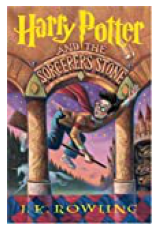

Такие рекомендации


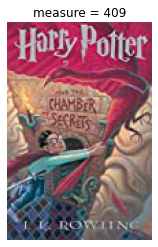

Harry Potter and the Chamber of Secrets (Book 2)


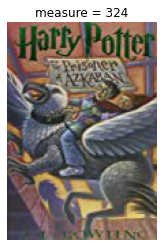

Harry Potter and the Prisoner of Azkaban (Book 3)


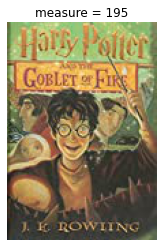

Harry Potter and the Goblet of Fire (Book 4)


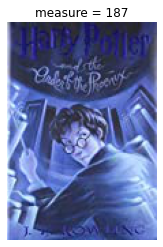

Harry Potter and the Order of the Phoenix (Book 5)


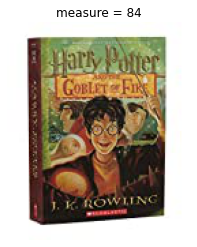

Harry Potter and the Goblet of Fire (Book 4)


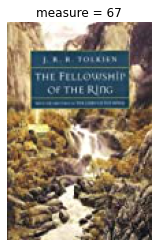

The Fellowship of the Ring (The Lord of the Rings, Part 1)


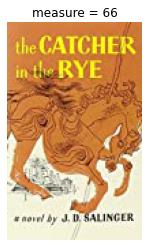

The Catcher in the Rye


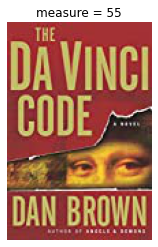

The Da Vinci Code


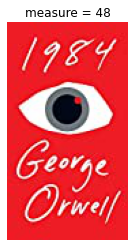

1984


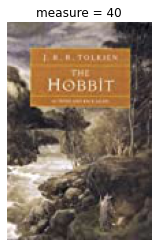

The Hobbit: or There and Back Again


In [639]:
cooc_rec_2.get_rec(7035)

Для товара


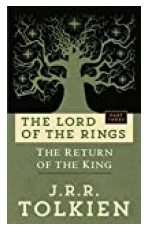

Такие рекомендации


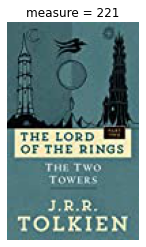

The Two Towers (The Lord of the Rings, Part 2)


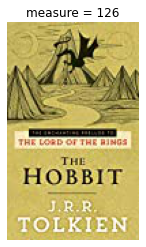

The Hobbit : The Enchanting Prelude to The Lord of the Rings


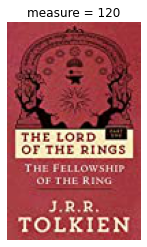

The Fellowship of the Ring (The Lord of the Rings, Part 1)


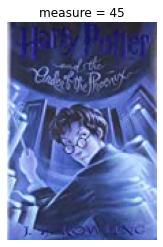

Harry Potter and the Order of the Phoenix (Book 5)


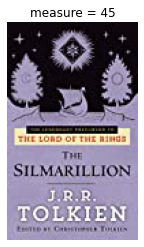

The Silmarillion


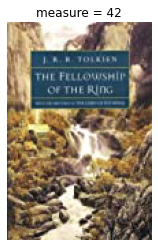

The Fellowship of the Ring (The Lord of the Rings, Part 1)


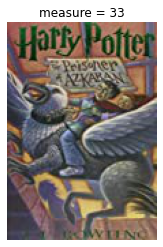

Harry Potter and the Prisoner of Azkaban (Book 3)


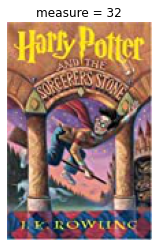

Harry Potter and the Sorcerer's Stone (Book 1)


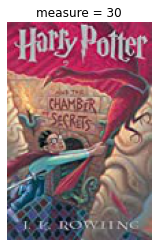

Harry Potter and the Chamber of Secrets (Book 2)


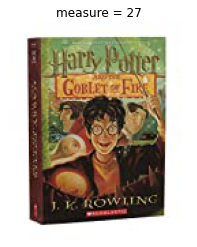

Harry Potter and the Goblet of Fire (Book 4)


In [647]:
cooc_rec_2.get_rec(1924)

Для товара


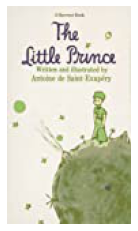

Такие рекомендации


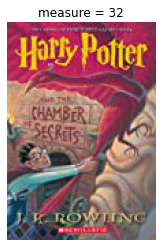

Harry Potter and the Chamber of Secrets (Book 2)


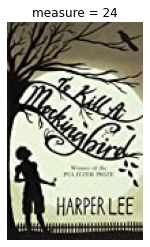

To Kill a Mockingbird


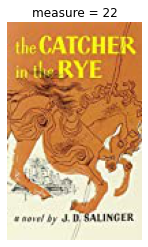

The Catcher in the Rye


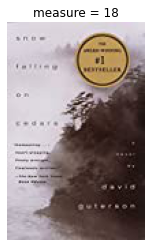

Snow Falling on Cedars


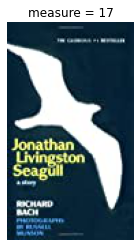

Jonathan Livingston Seagull


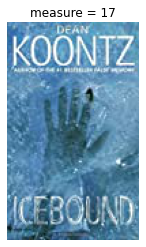

Icebound


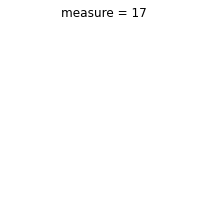

Dear Mr. Henshaw


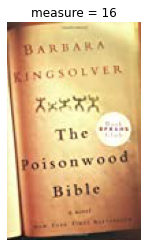

The Poisonwood Bible: A Novel


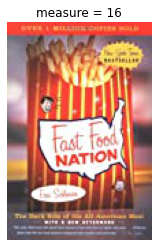

Fast Food Nation: The Dark Side of the All-American Meal


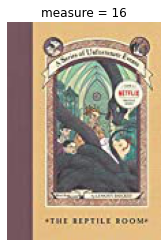

The Reptile Room (A Series of Unfortunate Events, Book 2)


In [649]:
cooc_rec_2.get_rec(1265)

### Content-based

In [651]:
books

,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher,Image-URL-S,Image-URL-M,Image-URL-L
0,0195153448,Classical Mythology,Mark P. O. Morford,2002,Oxford University Press,http://images.amazon.com/images/P/0195153448.0...,http://images.amazon.com/images/P/0195153448.0...,http://images.amazon.com/images/P/0195153448.0...
1,0002005018,Clara Callan,Richard Bruce Wright,2001,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...
2,0060973129,Decision in Normandy,Carlo D'Este,1991,HarperPerennial,http://images.amazon.com/images/P/0060973129.0...,http://images.amazon.com/images/P/0060973129.0...,http://images.amazon.com/images/P/0060973129.0...
3,0374157065,Flu: The Story of the Great Influenza Pandemic...,Gina Bari Kolata,1999,Farrar Straus Giroux,http://images.amazon.com/images/P/0374157065.0...,http://images.amazon.com/images/P/0374157065.0...,http://images.amazon.com/images/P/0374157065.0...
4,0393045218,The Mummies of Urumchi,E. J. W. Barber,1999,W. W. Norton &amp; Company,http://images.amazon.com/images/P/0393045218.0...,http://images.amazon.com/images/P/0393045218.0...,http://images.amazon.com/images/P/0393045218.0...
...,...,...,...,...,...,...,...,...
271355,0440400988,There's a Bat in Bunk Five,Paula Danziger,1988,Random House Childrens Pub (Mm),http://images.amazon.com/images/P/0440400988.0...,http://images.amazon.com/images/P/0440400988.0...,http://images.amazon.com/images/P/0440400988.0...
271356,0525447644,From One to One Hundred,Teri Sloat,1991,Dutton Books,http://images.amazon.com/images/P/0525447644.0...,http://images.amazon.com/images/P/0525447644.0...,http://images.amazon.com/images/P/0525447644.0...
271357,006008667X,Lily Dale : The True Story of the Town that Ta...,Christine Wicker,2004,HarperSanFrancisco,http://images.amazon.com/images/P/006008667X.0...,http://images.amazon.com/images/P/006008667X.0...,http://images.amazon.com/images/P/006008667X.0...
271358,0192126040,Republic (World's Classics),Plato,1996,Oxford University Press,http://images.amazon.com/images/P/0192126040.0...,http://images.amazon.com/images/P/0192126040.0...,http://images.amazon.com/images/P/0192126040.0...


In [849]:
class Content_Based_Books():
    def __init__(self, interactions, items):
        self.items = interactions[["product_id", "picture_url", "Book-Title"]].drop_duplicates()
        self.interactions = interactions.drop_duplicates()
        self.content_dict = {}
        for i in interactions[["product_id", "picture_url"]].drop_duplicates().values:
            self.content_dict[i[0]] = i[1]
        self.inversed_dict = {v: k for k, v in self.content_dict.items()}
        
    def avg_feature_vector(self, words, model, num_features, index2word_set):
        feature_vec = np.zeros((num_features, ), dtype='float32')
        n_words = 0
        for word in words:
            if word in index2word_set:
                n_words += 1
                feature_vec = np.add(feature_vec, model.wv[word])
        if (n_words > 0):
            feature_vec = feature_vec / n_words
        return feature_vec

    def get_items_representation(self):
        
        item_description = [gensim.utils.simple_preprocess(re.sub("[^a-zA-Zа-яА-Я]+", " ", i.lower())) 
                            for i in self.items['Book-Title']]
        #build vocabulary and train model
        self.model = gensim.models.Word2Vec(
                item_description,
                size=200,
                window=10,
                min_count=1,
                workers=10,
                iter=100)
        self.index2word_set = set(self.model.wv.index2word)
        self.items_embs = np.zeros((len(item_description), 200))
        for i in range(self.items_embs.shape[0]):
            self.items_embs[i] = self.avg_feature_vector(item_description[i], self.model, 200, self.index2word_set)
        
        
    def get_rec_I2I(self, i):
        metrics = cosine_similarity([self.items_embs[i]], self.items_embs)
        print(u"Для товара")
        rec_imaging([i], self.content_dict)
        print(u"Такие рекомендации")
        for k in range(1,11):
            rec_imaging([np.argsort(metrics)[0][::-1][k]], self.content_dict, [np.sort(metrics)[0][::-1][k]])
            print(self.items[self.items['product_id'] == np.argsort(metrics)[0][::-1][k]]['Book-Title'].values)


    def get_rec_U2I(self, i):
        ui = self.interactions[self.interactions["vid"] == i]
        user_vector = " ".join(ui["Book-Title"])
        user_processed = gensim.utils.simple_preprocess(re.sub("[^a-zA-Zа-яА-Я]+", " ", user_vector.lower()))
        user_emb = self.avg_feature_vector(user_processed, self.model, 200, self.index2word_set)
        metrics = cosine_similarity([user_emb], self.items_embs)
        print(u"Для пользователя, который взаимодействовал с товарами")
        rec_imaging(np.unique([self.inversed_dict[i] for i in ui["Image-URL-M"]]), self.content_dict)
        print(u"Такие рекомендации")
        for k in range(1,11):
            rec_imaging([np.argsort(metrics)[0][::-1][k]], self.content_dict, [np.sort(metrics)[0][::-1][k]])
            print(self.items[self.items['product_id'] == np.argsort(metrics)[0][::-1][k]]['Book-Title'].values)

In [850]:
CB2 = Content_Based_Books(interactions, books)

CB2.get_items_representation()


Для товара


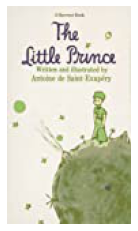

Такие рекомендации


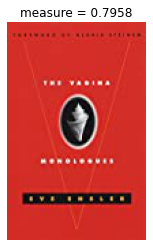

['The Vagina Monologues']


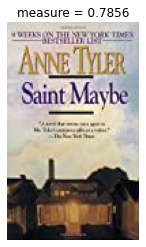

['Saint Maybe']


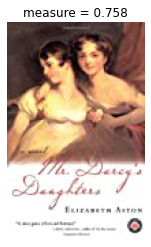

["Mr. Darcy's Daughters : A Novel"]


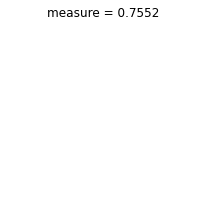

["Dirk Gently's Holistic Detective Agency"]


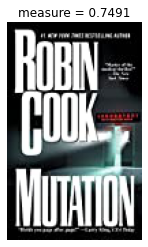

['Mutation']


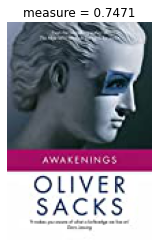

['Awakenings']


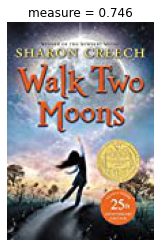

['Walk Two Moons']


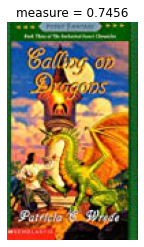

['Calling on Dragons (Read with Me Paperbacks)']


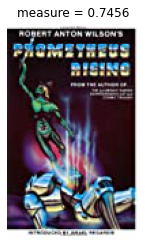

['Prometheus Rising']


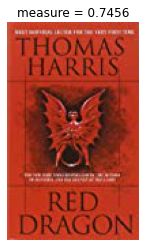

['Red Dragon']


In [851]:
CB2.get_rec_I2I(1265)

###  Коллаборативная фильтрация

In [989]:
class Colloborative_Books():
    def __init__(self, interactions):
        self.content_dict = {}
        for i, j in interactions[["product_id", "picture_url"]].drop_duplicates().values:
            self.content_dict[int(i)] = j
        df_weights = pd.DataFrame({"Book-Rating": [1, 2, 3, 4, 5, 6, 7, 8, 9, 10],
                                   'weight': [0, 0, 0, 0, 0, 1, 1, 1, 1, 1]})
        weighted = interactions.merge(df_weights, on="Book-Rating")\
                          .groupby(["vid", "product_id", "picture_url"])["weight"]\
                          .sum()\
                          .reset_index()
        weighted["weight"] = (weighted["weight"] > 0).astype(int)
        self.csr_rates = coo_matrix((weighted["weight"], (weighted["vid"], weighted["product_id"])), 
                            shape=(len(set(weighted["vid"])), len(set(weighted["product_id"]))))
        

    def user_based(self, idx):
        user_rates = self.csr_rates.getrow(idx).toarray()[0]
        watched_items = np.where(user_rates != 0)[0]
        # считаем косинус между пользователем idx и всеми пользователями
        metrics = cosine_similarity([user_rates], self.csr_rates).reshape(-1, 1)
        # домножаем оценки пользователя на коэффициент похожести
        rates = csr_matrix.multiply(self.csr_rates.copy(), metrics)
        # чтобы не рекомендовать уже просмотренные - зануляем веса просмотренных
        total_rate = (1 - user_rates.astype(bool)) * np.array(np.sum(rates, axis=0))[0]
        # печатаем рекомендации
        self.get_rec(watched_items, np.arange(self.csr_rates.shape[1])[np.argsort(total_rate)[::-1][:10]],
                    np.sort(total_rate)[::-1][:10])
        
    def item_based(self, idx):
        item_rates = self.csr_rates.getcol(idx).toarray().reshape(1, -1)
        # считаем косинус между товаром idx и всеми пользователями
        metrics = cosine_similarity(item_rates, self.csr_rates.T).reshape(-1, 1)
        # домножаем оценки пользователя на коэффициент похожести
        rates = csr_matrix.multiply(self.csr_rates.T.copy(), metrics)
        total_rate = np.array(np.sum(rates, axis=1)).ravel()
        # печатаем рекомендации
        self.get_rec([idx], np.arange(self.csr_rates.shape[1])[np.argsort(total_rate)[::-1][:10]],
                    np.sort(total_rate)[::-1][:10])

    def get_rec(self, watched, recs, measure):
        print(u"Для таких товаров")
        rec_imaging([i for i in watched], self.content_dict)
        print(u"Такие рекомендации")
        rec_imaging([i for i in recs], self.content_dict, measure)

In [990]:
clb1 = Colloborative_Books(interactions)

Для таких товаров


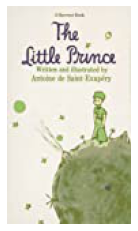

Такие рекомендации


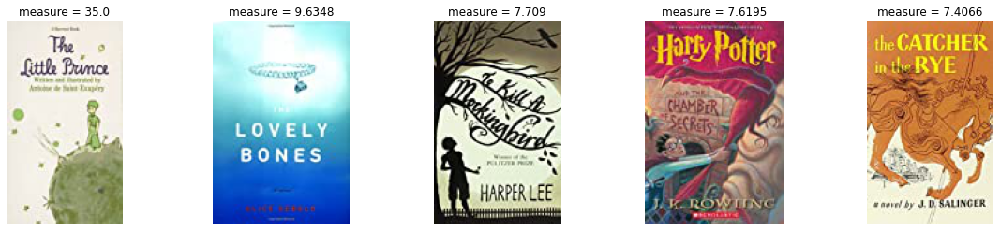

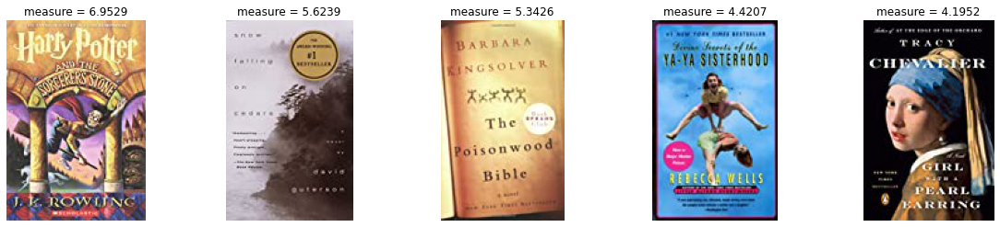

In [991]:
clb1.item_based(1265)

Для таких товаров


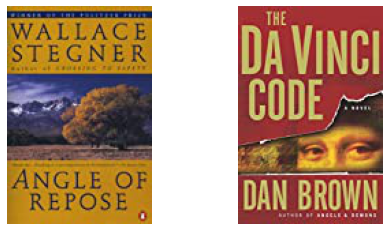

Такие рекомендации


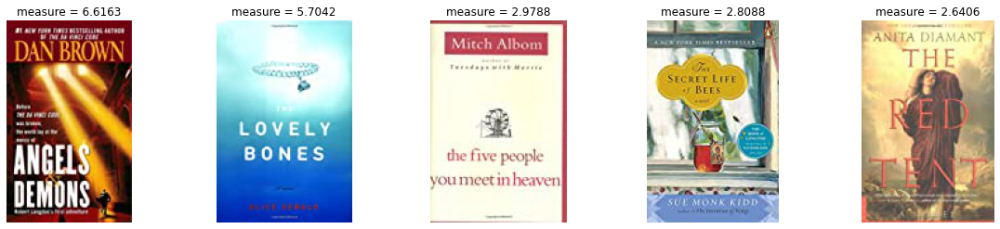

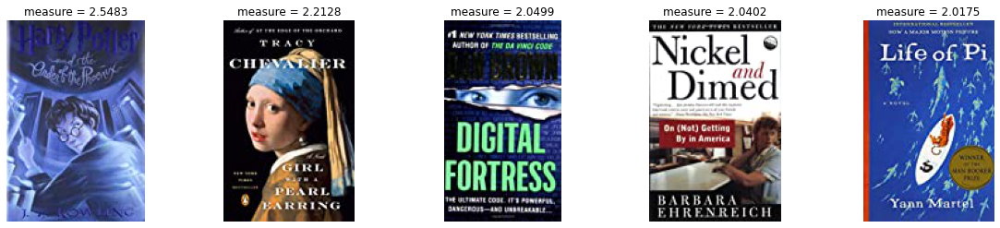

In [992]:
clb1.user_based(1265)

### Матричная факторизация

In [867]:
class BooksMatrixFactorization():
    
    def __init__(self, interactions, k, csr_rates):
        self.inter = interactions[["product_id", "Book-Title"]].drop_duplicates()
        interactions["product_id"] = interactions["product_id"].astype(int)
        self.k = k
        self.content_dict = {}
        for i, j in interactions[["product_id", "picture_url"]].drop_duplicates().values:
            self.content_dict[i] = j
        self.csr_rates = csr_rates
        
    def MF(self):
        U, S, V = svds(self.csr_rates.astype(float), k=self.k)
        self.user_embs = U
        self.items_embs = V.T
        
    def LightFM(self):
        self.model = LightFM(loss='warp', no_components=100, learning_rate=0.03, learning_schedule="adadelta")
        self.model.fit(self.csr_rates, epochs=5, num_threads=40, verbose=True)
        self.user_feature_bias, self.user_feature_embeddings = self.model.get_user_representations()
        self.item_feature_bias, self.items_embs = self.model.get_item_representations()

    def get_item_rec(self, i):
        metrics = cosine_similarity([self.items_embs[i]], self.items_embs)
        print(u"Для товара")
        rec_imaging([i], self.content_dict)
        print(u"Такие рекомендации")
        for k in range(1,11):
            rec_imaging([np.argsort(-metrics)[0][k]], self.content_dict, [-np.round(np.sort(-metrics)[0][k], 4)])
            print(self.inter[self.inter['product_id'] == np.argsort(-metrics)[0][k]]['Book-Title'].values)
    
    def get_user_rec(self, i):
        metrics = cosine_similarity([self.user_embs[i]], self.items_embs)
        print(u"Для Пользователя", i)
        print(u"Такие рекомендации")
        for k in range(1,11):
            rec_imaging([np.argsort(-metrics)[0][k]], self.content_dict, [-np.round(np.sort(-metrics)[0][k], 4)])
            print(self.inter[self.inter['product_id'] == np.argsort(-metrics)[0][k]]['Book-Title'].values)

In [868]:
MF2 = BooksMatrixFactorization(interactions, 300, csr_rates)
MF2.MF()

Для товара


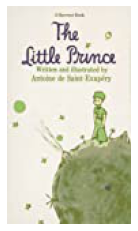

Такие рекомендации


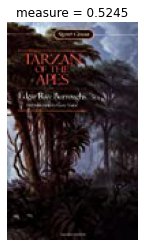

['Tarzan of the Apes (Tarzan)']


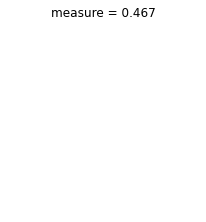

['War and Peace (Wordsworth Classics)']


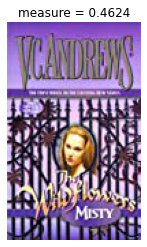

['Misty (Wildflowers)']


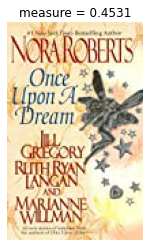

['Once upon a Dream']


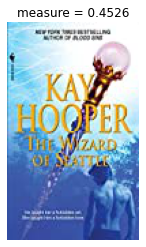

['The Wizard of Seattle']


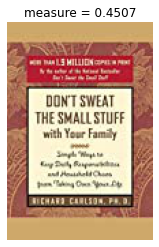

["Don't Sweat the Small Stuff with Your Family : Simple Ways to Keep Daily Responsibilities and Household Chaos from Taking Over Your Life (Don't Sweat the Small Stuff Series)"]


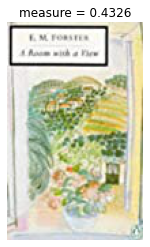

['Room With a View']


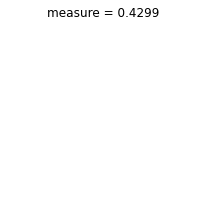

['Motherhood: The Second Oldest Profession']


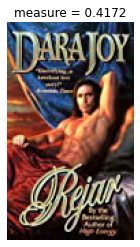

['Rejar (Timeswept)']


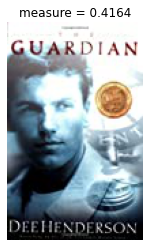

["The Guardian (O'Malley #2)"]


In [869]:
MF2.get_item_rec(1265)

Для Пользователя 60
Такие рекомендации


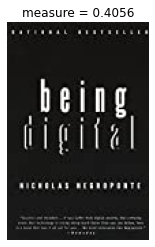

['Being Digital']


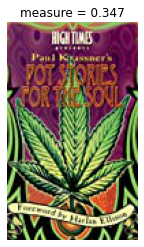

["High Times Presents Paul Krassner's Pot Stories for the Soul"]


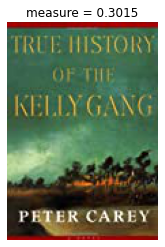

['True History of the Kelly Gang']


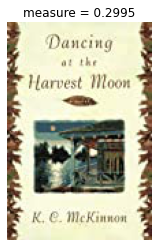

['Dancing at the Harvest Moon: A Novel']


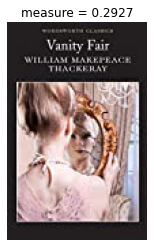

['Vanity Fair (Wordsworth Collection)']


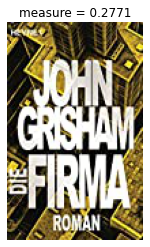

['Die Firma. Roman.']


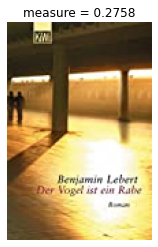

['Der Vogel ist ein Rabe']


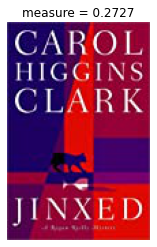

['Jinxed : A Regan Reilly Mystery']


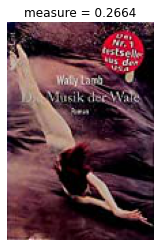

['Die Musik Der Wale']


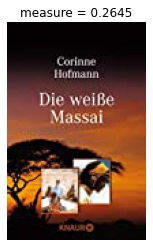

['Die weiÃ?Â?e Massai.']


In [870]:
MF2.get_user_rec(60)